# Cloud Cognitive Environments
Plataforma Amazon Web Services

## Requerimentos

* Boto3
* Matplotlib

## Materiais auxiliares

Baixe o repositório abaixo utilizado o comando indicado. Em caso de atualização, apague o diretório antes e depois clone o repositório.

In [ ]:
# Apagar pasta do repositório
# Faça somente isso se não tenha clonado antes
!rm -rf fiap-ds-cloud-cognitive-environments

In [ ]:
%cd ..

/content


In [ ]:
# Clonar o repositório da aula
!git clone https://github.com/michelpf/fiap-ds-cloud-cognitive-environments

Cloning into 'fiap-ds-cloud-cognitive-environments'...
remote: Enumerating objects: 61, done.
remote: Total 61 (delta 0), reused 0 (delta 0), pack-reused 61
Receiving objects: 100% (61/61), 111.17 MiB | 16.23 MiB/s, done.
Resolving deltas: 100% (8/8), done.
Updating files: 100% (21/21), done.


In [ ]:
%cd fiap-ds-cloud-cognitive-environments/

/content/fiap-ds-cloud-cognitive-environments


Apesar de muitas bibliotecas já estarem instaladas no Colab, o Boto3 é uma das que ainda não estão, portanto requer instalação manual.

In [ ]:
# Instalação da biblioteca Boto3, sempre obter a última versão
!pip install boto3

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.8/135.8 kB 1.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.1/11.1 MB 59.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.8/79.8 kB 9.5 MB/s eta 0:00:00


In [ ]:
import boto3
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

Crie um usuário dedicado para a aula, conforme indicado no material. Após isso, obtenha a chave de identificação (```ACCESS_ID```) e de acesso (```ACCESS_KEY```).

Nunca versione ou disponibilize as chaves de acesso em repositórios, somente (em último caso quando somente você tem acesso) em repositórios privados.

Utilizaremos a região de ```us-east-1```, região mais barata dos serviços da AWS.

In [ ]:
ACCESS_ID = "chave"
ACCESS_KEY = "secret"
region = "us-east-1"

# Amazon Textract

Serviço especilizado em lidar com OCR (Optical Character Recognition), ou seja, é capaz de identificar texto em imagens.

Utiliza os formatos de imagem (JPG e PNG) e documento (PDF).

Tamanho máximo de 5 MB com até 11 páginas por documento (PDF).

Consulte a [documentação](https://docs.aws.amazon.com/textract/index.html).

In [ ]:
from matplotlib import rcParams as mpl_param

mpl_param["figure.dpi"] = 200

No exemplo abaixo vamos utilizar o serviço para reconhecimento do texto de um cupom fiscal no formato JPG.

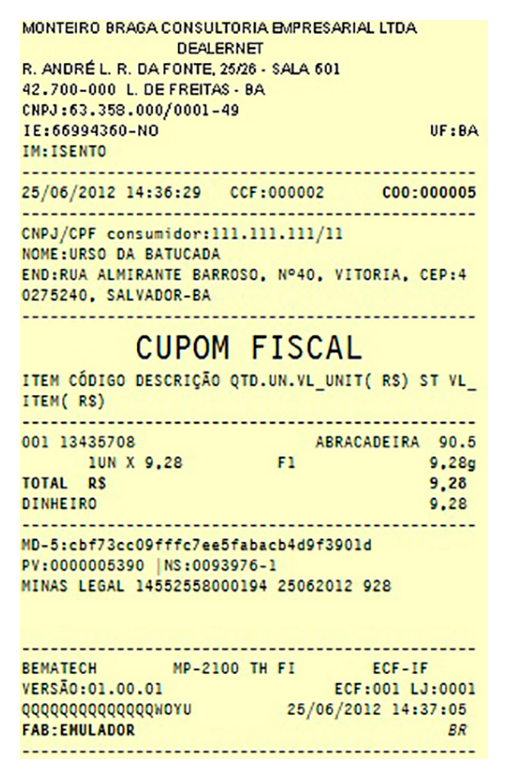

In [ ]:
img = mpimg.imread("aula-1-introducao/imagens/cupom-fiscal-1.jpg")
imgplot = plt.imshow(img)

plt.axis('off')
plt.show()

Podemos fazer de 2 formas, a primeira é enviar os dados binários da imagem para a API (por meio do SDK). A segunda é informar a localização do bucket S3.

In [ ]:
# caminho e nome do arquivo
file_name = "aula-1-introducao/imagens/cupom-fiscal-1.jpg"

# abrimos o arquivo e lemos os dados em formato binário
with open(file_name, "rb") as file:
  img_test = file.read()
  bytes_test = bytearray(img_test)

# criamos uma sessão nova, isto pode ser feito uma única vez para diferentes tipos de clientes, como o textract
# passamos as credenciais de acesso
session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)

# criamos o cliente para utilizar o serviço
client = session.client('textract', region_name=region)

# enviamos a solicitação, configramos o tipo de feature no formato de formulário, mas poderíamos alterar para outro formato como um especializado em tabelas (TABLE)
response = client.analyze_document(Document={'Bytes': bytes_test}, FeatureTypes=['FORMS'])

A instrução abaixo é quando utilizamos o arquivo diretamente no S3. É mais rápido e mais integrado com outros serviços da AWS.

In [ ]:
# nome do bucket no S3
bucket_name = "fiap-cognitive-platforms"

# nome do arquivo incluido pastas e subpastas
file_name = "docs/cupom-fiscal/cupom-fiscal-1.jpg"

# caminho do documento no S3, formato que o SDK espera
document_s3 = {"S3Object": {"Bucket" : bucket_name, "Name": file_name}}

# criação da sessão
session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)

# criação do cliente
client = session.client('textract', region_name=region)

# requisição da API passando o documento no formato S3
response = client.analyze_document(Document=document_s3, FeatureTypes=['FORMS'])

In [ ]:
response

{'DocumentMetadata': {'Pages': 1},
 'Blocks': [{'BlockType': 'PAGE',
   'Geometry': {'BoundingBox': {'Width': 1.0,
     'Height': 1.0,
     'Left': 0.0,
     'Top': 0.0},
    'Polygon': [{'X': 1.585354141298012e-07, 'Y': 0.0},
     {'X': 1.0, 'Y': 6.304496764641954e-06},
     {'X': 1.0, 'Y': 1.0},
     {'X': 0.0, 'Y': 0.9975343942642212}]},
   'Id': '29c087f6-5995-45ec-996b-31c4a9d620e1',
   'Relationships': [{'Type': 'CHILD',
     'Ids': ['8eeaee34-d1f2-4461-9fed-dfc9194d35cc',
      '69de4744-732a-4a1d-ba11-515186f74368',
      'ef1433aa-c7f4-448d-8b75-4285193c6cbc',
      '3d0a4a36-7cf6-4776-ad90-3d28dc4e59d0',
      'f4c2001e-3b6f-402a-9f76-bbf2ebced4a1',
      '6041ef36-cbbc-49e3-a849-d9c677209e20',
      '112be067-ac6e-472e-a810-d67e4ed0beb8',
      'db1f8c07-aec6-44a8-9efb-e180549c17e5',
      'b9f98b6c-2e08-4eec-a42d-6aa3b720aadf',
      '448de303-14ac-47ad-85db-d4638a58caf5',
      '97ecca82-469f-418a-a6eb-07bed3b0d015',
      '3d8a6ce5-ef24-4de9-8ab2-b79a740d546a',
      '02e

Cada identificação é feito por blocos, representando dados como grau de confiança, caixa delimitadora e o texto identificado.

In [ ]:
blocks = response["Blocks"]

Nosso objetivo é buscar apenas as palavras (bloco do tipo WORD), portanto vamos ignorar outros tipos de blocos gráficos, como por exemplo LINE.

In [ ]:
for block in blocks:
  if block["BlockType"] == "WORD":
      print(block)

{'BlockType': 'WORD', 'Confidence': 99.1909408569336, 'Text': 'MONTEIRO', 'TextType': 'PRINTED', 'Geometry': {'BoundingBox': {'Width': 0.16584299504756927, 'Height': 0.017666451632976532, 'Left': 0.0032015624456107616, 'Top': 0.0019437094451859593}, 'Polygon': [{'X': 0.0032028346322476864, 'Y': 0.0019437094451859593}, {'X': 0.16904455423355103, 'Y': 0.0023132427595555782}, {'X': 0.16904117166996002, 'Y': 0.01961016096174717}, {'X': 0.0032015624456107616, 'Y': 0.019239557906985283}]}, 'Id': 'f6fcd589-f01f-4ff6-b2e3-4f505a6967ab'}
{'BlockType': 'WORD', 'Confidence': 99.76378631591797, 'Text': 'BRAGA', 'TextType': 'PRINTED', 'Geometry': {'BoundingBox': {'Width': 0.11155720800161362, 'Height': 0.01786358840763569, 'Left': 0.18150483071804047, 'Top': 0.0018074649851769209}, 'Polygon': [{'X': 0.18150843679904938, 'Y': 0.0018074649851769209}, {'X': 0.2930620312690735, 'Y': 0.002056009601801634}, {'X': 0.29305699467658997, 'Y': 0.019671054556965828}, {'X': 0.18150483071804047, 'Y': 0.019421776

Vamos refinar mais ainda para somente analisarmos os texto com alto grau de confiança. Nesse caso vamos trazer os textos acima de 50%.

In [ ]:
for block in blocks:
  if block["BlockType"] == "WORD" and int(block["Confidence"])>50:
      print(block["Text"])

MONTEIRO
BRAGA
CONSULTORIA
EMPRESARIAL
LTDA
DEALERNET
R.
ANDRE
L.
R.
DAFONTE,
25/26
-
SALA
601
42.700-000
L.
DE
FREITAS
BA
CNPJ:63.358.000/0001-49
IE:66994360-NO
UF:BA
IM:
ISENTO
25/06/2012
14:36:29
CCF:000002
C00:000005
CNPJ/CPF
consumidor:111.111.111/11
NOME:URSO
DA
BATUCADA
END:RUA
ALMIRANTE
BARROSO,
N°40.
VITORIA,
CEP:4
0275240,
SALVADOR-BA
CUPOM
FISCAL
ITEM
CÓDIGO
DESCRIÇÃO
ST
VL
ITEM
(
RS)
001
13435708
ABRACADEIRA
90.5
1UN
X
9.28
F1
9.28g
TOTAL
R$
9.28
DINHEIRO
9.28
PV:0000005390
|
NS:0093976-1
MINAS
LEGAL
14552558000194
25062012
928
BEMATECH
MP-2100
TH
FI
ECF-IF
ECF:001
LJ:0001
25/06/2012
14:37:05
FAB:
EMULADOR
BR


Para facilitar o processamento em outros arquivos, vamos criar uma função que encapsule estas transnformações e exiba a imagem antes de decodificar.

In [ ]:
# função para ser re-utilizada várias vezes
def processar_arquivo(file_name):

  # lendo o arquivo em imagem para exibir
  img = mpimg.imread(file_name)
  imgplot = plt.imshow(img)

  plt.axis('off')
  plt.show()

  with open(file_name, "rb") as file:
    img_test = file.read()
    bytes_test = bytearray(img_test)


  session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)
  client = session.client('textract', region_name=region)
  response = client.analyze_document(Document={'Bytes': bytes_test}, FeatureTypes=['FORMS'])

  blocks = response["Blocks"]

  for block in blocks:
    if block["BlockType"] == "WORD" and int(block["Confidence"])>50:
      print(block["Text"])

Processando outro arquivo de exemplo.

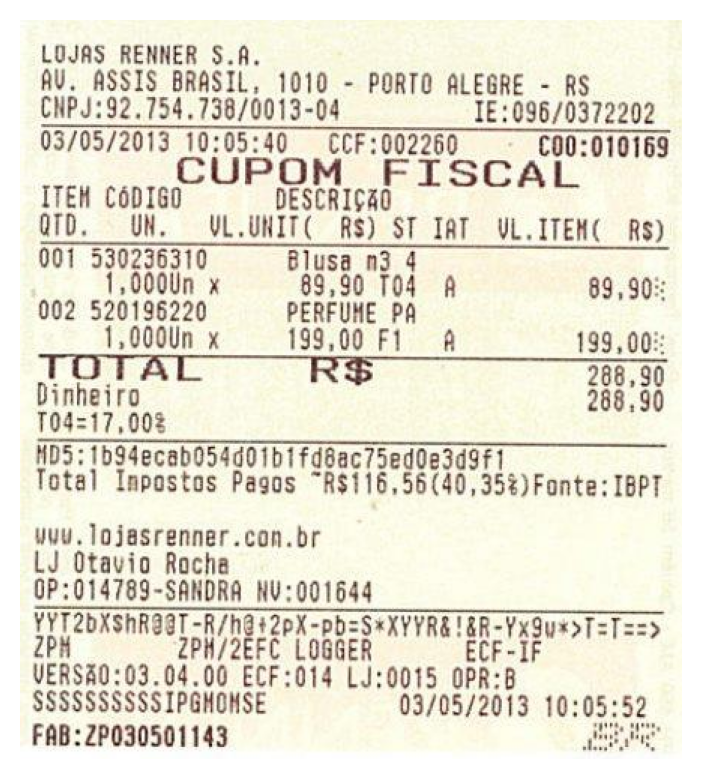

LOJAS
RENNER
S.A.
AV.
ASSIS
BRASIL.
1010
-
PORTO
ALEGRE
-
RS
CNPJ:92.754.738/0013-04
IE:096/0372202
03/05/2013
10:05:40
:002260
C00:010169
CUPOM
FISCAL
ITEM
CóDIGO
DESCRIÇÃO
QTD.
UN.
VL.UNIT(
R$)
ST
IAT
VL.
ITEM(
RS)
001
530236310
Blusa
n3
4
1,000Un
X
89,90
T04
A
520196220
PERFUME
PA
1,000Un
X
199,00
F1
A
TOTAL
R$
288,90
Dinheiro
288,90
T04=17.00%
MD5:1b94ecab054d01b1fd8ac75ed0e3d9f1
Total
Inpostos
Pagos
Fonte:
IBPT
www.lojasrenner.com.br
LJ
Otavio
Rocha
OP:
NV:001644
ZPM
ZPH/2EFC
LOGGER
ECF-IF
ECF:014
LJ:0015
OPR:B
SSSSSSSSSSIPGMONSE
03/05/2013
10:05:52
FAB:ZP030501143


In [ ]:
processar_arquivo("aula-1-introducao/imagens/cupom-fiscal-2.jpg")

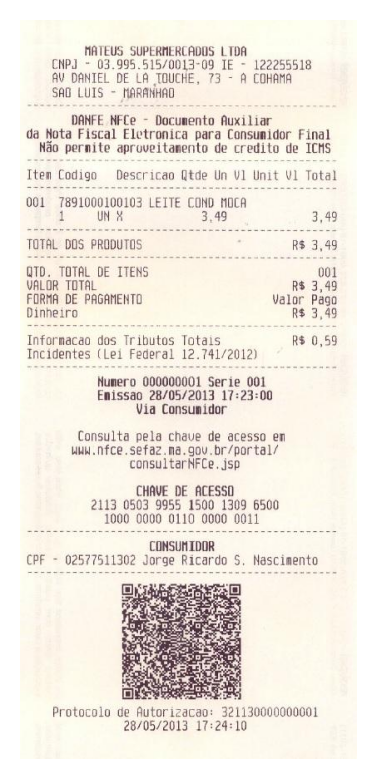

MATEUS
SUPERMERCADOS
LTDA
CNPJ
-
03.995.515/0013-09
IE
-
122255518
AV
DANIEL
DE
LA
TOUCHE.
73
-
A
COHAMA
SAO
LUIS
-
MARANHAO
DANFE
NFCe
-
Documento
Auxilian
da
Nota
Fiscal
Eletronica
para
Consumidor
Final
Não
permite
aproveitamento
de
credito
de
ICMS
Item
Codigo
Descricao
Qtde
Un
V1
Unit
V1
Total
001
7891000100103
LEITE
COND
MOCA
1
UN
3.49
3.49
TOTAL
DOS
PRODUTOS
R$
3,49
QTD.
TOTAL
DE
ITENS
001
VALOR
TOTAL
R$
3,49
FORMA
DE
PAGAMENTO
Valor
Pago
Dinheiro
R$
3,49
Informacao
dos
Tributos
Totais
R$
0,59
Incidentes
(Lei
Federal
12.741/2012)
Numero
000000001
Serie
001
Emissao
28/05/2013
17:23:00
Via
Consumidor
Consulta
pela
chave
de
acesso
en
www.nfce.sefaz.ma.gov.br/portal/
consultarNFCe.js
CHAVE
DE
ACESSO
2113
0503
9955
1500
1309
6500
1000
0000
0110
0000
0011
CONSUMIDOR
CPF
-
02577511302
Jorge
Ricardo
S.
Nascimento
Protocolo
de
Autorizacao:
321130000000001
28/05/2013
17:24:10


In [ ]:
processar_arquivo("aula-1-introducao/imagens/cupom-fiscal-3.png")

# Amazon Rekognition

Serviço reponsável em análises de imagens, sendo capaz de ser utilizadas para descritor de imagens, classificação de imagens além de funções especializadas para análise facial como detecção, identificação e reconhecimento de faces.

Consulte a [documentação](https://boto3.amazonaws.com/v1/documentation/api/latest/reference/services/rekognition.html#rekognition).

Assim como o Textract, podemos utilizar a análise a partir de imagem no formato binário ou diretamente por um bucket do S3.



## Descritor de cena

Essa função irá detectar todos os objetos (ou labels) numa imagem, retornando o nome de cada classe, porcentagem de confiança e caixa delimitadora.

Vamos utilizar a seguinte imagem como exemplo.

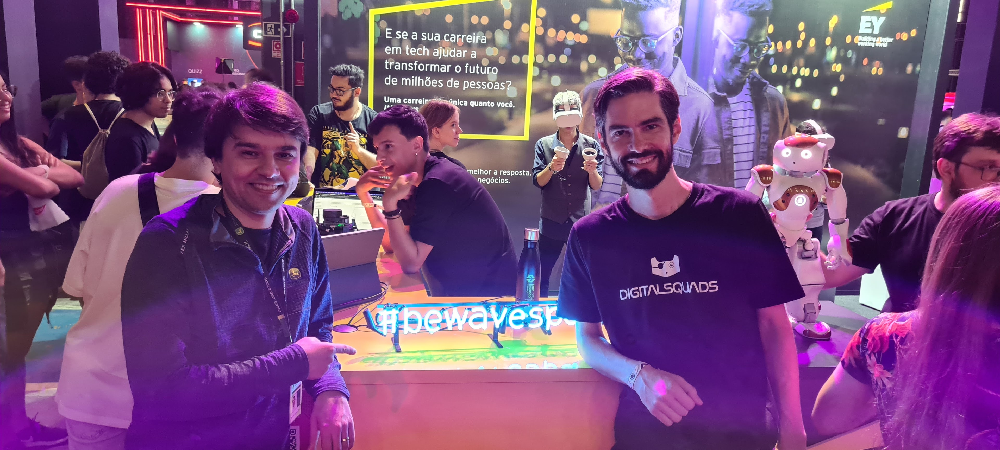

In [ ]:
# neste caso, como vamos manipular a imagem, vamos utilizar a exibição também com o componente PIL
imagem = Image.open("aula-1-introducao/imagens/michel-friends.jpg")
imagem

In [ ]:
# arquivo de imagem para análise
file_name = "aula-1-introducao/imagens/michel-friends.jpg"

# conversão da imagem em binário
with open(file_name, "rb") as file:
  img_file = file.read()
  bytes_file = bytearray(img_file)

# abrindo uma sessão
session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)

# criando um cliente
client = session.client("rekognition", region_name=region)

# requisição para o descritor de cena
response = client.detect_labels(
    Image={'Bytes': bytes_file},
    MaxLabels=10, # Número máximo de rótulos retornados
    MinConfidence=70 # Confiança mínima necessária para considerar um rótulo
)

In [ ]:
response

{'Labels': [{'Name': 'Urban',
   'Confidence': 99.98980712890625,
   'Instances': [],
   'Parents': [],
   'Aliases': [],
   'Categories': [{'Name': 'Colors and Visual Composition'}]},
  {'Name': 'Adult',
   'Confidence': 98.67523956298828,
   'Instances': [{'BoundingBox': {'Width': 0.14372475445270538,
      'Height': 0.4697018563747406,
      'Left': 0.5793469548225403,
      'Top': 0.0},
     'Confidence': 98.67523956298828},
    {'BoundingBox': {'Width': 0.2395206093788147,
      'Height': 0.8204092383384705,
      'Left': 0.1193152666091919,
      'Top': 0.17959074676036835},
     'Confidence': 98.20369720458984},
    {'BoundingBox': {'Width': 0.25174376368522644,
      'Height': 0.8492631316184998,
      'Left': 0.5560481548309326,
      'Top': 0.150701105594635},
     'Confidence': 98.01235961914062},
    {'BoundingBox': {'Width': 0.1588333398103714,
      'Height': 0.43921998143196106,
      'Left': 0.35971757769584656,
      'Top': 0.22539536654949188},
     'Confidence': 97.1

Vamos analisar cada item da resposta.
Em cada item temos um conjunto de objetos para um determinado label, que chamamos de categorias. Ou seja, os objetos que são detectados estão dentro das instâncias, como pessoas o objetos.

In [ ]:
for item in response:
  print(response)

{'Labels': [{'Name': 'Urban', 'Confidence': 99.98980712890625, 'Instances': [], 'Parents': [], 'Aliases': [], 'Categories': [{'Name': 'Colors and Visual Composition'}]}, {'Name': 'Adult', 'Confidence': 98.67523956298828, 'Instances': [{'BoundingBox': {'Width': 0.14372475445270538, 'Height': 0.4697018563747406, 'Left': 0.5793469548225403, 'Top': 0.0}, 'Confidence': 98.67523956298828}, {'BoundingBox': {'Width': 0.2395206093788147, 'Height': 0.8204092383384705, 'Left': 0.1193152666091919, 'Top': 0.17959074676036835}, 'Confidence': 98.20369720458984}, {'BoundingBox': {'Width': 0.25174376368522644, 'Height': 0.8492631316184998, 'Left': 0.5560481548309326, 'Top': 0.150701105594635}, 'Confidence': 98.01235961914062}, {'BoundingBox': {'Width': 0.1588333398103714, 'Height': 0.43921998143196106, 'Left': 0.35971757769584656, 'Top': 0.22539536654949188}, 'Confidence': 97.18771362304688}, {'BoundingBox': {'Width': 0.17932751774787903, 'Height': 0.46211522817611694, 'Left': 0.8206724524497986, 'Top'

Para podermos desenhar os objetos identificados na imagem original vamos utilizar o PIL e também uma fonte para podermos controlar o tamanho dela.

In [ ]:
from PIL import Image, ImageDraw, ImageFont

# carregar fonte para controlar tamanho
font = ImageFont.truetype("aula-1-introducao/font/arial.ttf", 50)

In [ ]:
# selecionar imagem para manipulação
image = Image.open("aula-1-introducao/imagens/michel-friends.jpg")

# obtendo tamanhos para os cálculos das caixas delimitadoras que são ponderadas
imgWidth, imgHeight = image.size

# associado a imagem para manipulação
draw = ImageDraw.Draw(image)

# lista de posicionamento para controlar a sobreposição
top_left = []

# lista de objetos detectados
objects = []

# analisando cada label
for item in response["Labels"]:
  print("Label: " + str(item))

  # analisando cada instância
  for instance in item["Instances"]:
    print("Instance: " + str(instance))
    objects.append(item["Name"])

    # obtendo a caixa delimitadora
    box = instance['BoundingBox']

    top = imgHeight * box['Top']
    left = imgWidth * box['Left']
    width = imgWidth * box['Width']
    height = imgHeight * box['Height']

    # caso o valor do top_left exista na lista vamos deixar o posicionamento
    # 50 pixels mais abaixo para evitar o sobreposicionamento
    while top in top_left:
      top = top - 50

    top_left.append(top)

    print("Left: " + "{0:.0f}".format(left))
    print("Top: " + "{0:.0f}".format(top))
    print("Face Width: " + "{0:.0f}".format(width))
    print("Face Height: " + "{0:.0f}".format(height))

    # desenhando a caixa delimitadora
    draw.rectangle([left,top, left + width, top + height], outline='#00d400')

    # escrevendo o nome respecitivo
    draw.text((left, top), item["Name"], font=font)
    print("Name:" + item["Name"])

Label: {'Name': 'Urban', 'Confidence': 99.98980712890625, 'Instances': [], 'Parents': [], 'Aliases': [], 'Categories': [{'Name': 'Colors and Visual Composition'}]}
Label: {'Name': 'Adult', 'Confidence': 98.67523956298828, 'Instances': [{'BoundingBox': {'Width': 0.14372475445270538, 'Height': 0.4697018563747406, 'Left': 0.5793469548225403, 'Top': 0.0}, 'Confidence': 98.67523956298828}, {'BoundingBox': {'Width': 0.2395206093788147, 'Height': 0.8204092383384705, 'Left': 0.1193152666091919, 'Top': 0.17959074676036835}, 'Confidence': 98.20369720458984}, {'BoundingBox': {'Width': 0.25174376368522644, 'Height': 0.8492631316184998, 'Left': 0.5560481548309326, 'Top': 0.150701105594635}, 'Confidence': 98.01235961914062}, {'BoundingBox': {'Width': 0.1588333398103714, 'Height': 0.43921998143196106, 'Left': 0.35971757769584656, 'Top': 0.22539536654949188}, 'Confidence': 97.18771362304688}, {'BoundingBox': {'Width': 0.17932751774787903, 'Height': 0.46211522817611694, 'Left': 0.8206724524497986, 'Top

Lista de objetos detectados.

In [ ]:
objects

['Adult',
 'Adult',
 'Adult',
 'Adult',
 'Adult',
 'Adult',
 'Adult',
 'Male',
 'Male',
 'Male',
 'Male',
 'Male',
 'Male',
 'Man',
 'Man',
 'Man',
 'Man',
 'Man',
 'Man',
 'Person',
 'Person',
 'Person',
 'Person',
 'Person',
 'Person',
 'Person',
 'Person',
 'Person',
 'Person',
 'Person',
 'Person',
 'Person',
 'Person',
 'Person',
 'Person',
 'Glasses',
 'Glasses',
 'Glasses',
 'Glasses',
 'Backpack',
 'Female',
 'Woman']

In [ ]:
# removendo duplicados
objects = set(objects)
objects

{'Adult', 'Backpack', 'Female', 'Glasses', 'Male', 'Man', 'Person', 'Woman'}

Exibindo a imagem anotada.

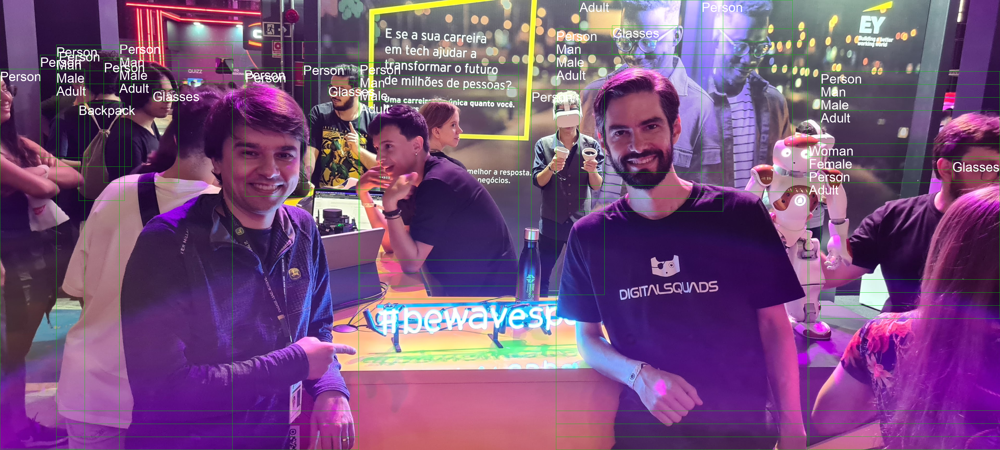

In [ ]:
image

## Detector de faces

Essa função irá detectar faces em uma imagem, trazendo as informações de caixa delimitadora e também aspectos da própria face, como:

*   Idade
*   Gênero
*   Pelos faciais
*   Sentimento
*   Abertura e fechamento dos olhos
*   Abertura e fechamento da boca
*   Posicionamento da face e elementos da face

A função é capaz de detectar múltiplas faces em uma mesma imagem.

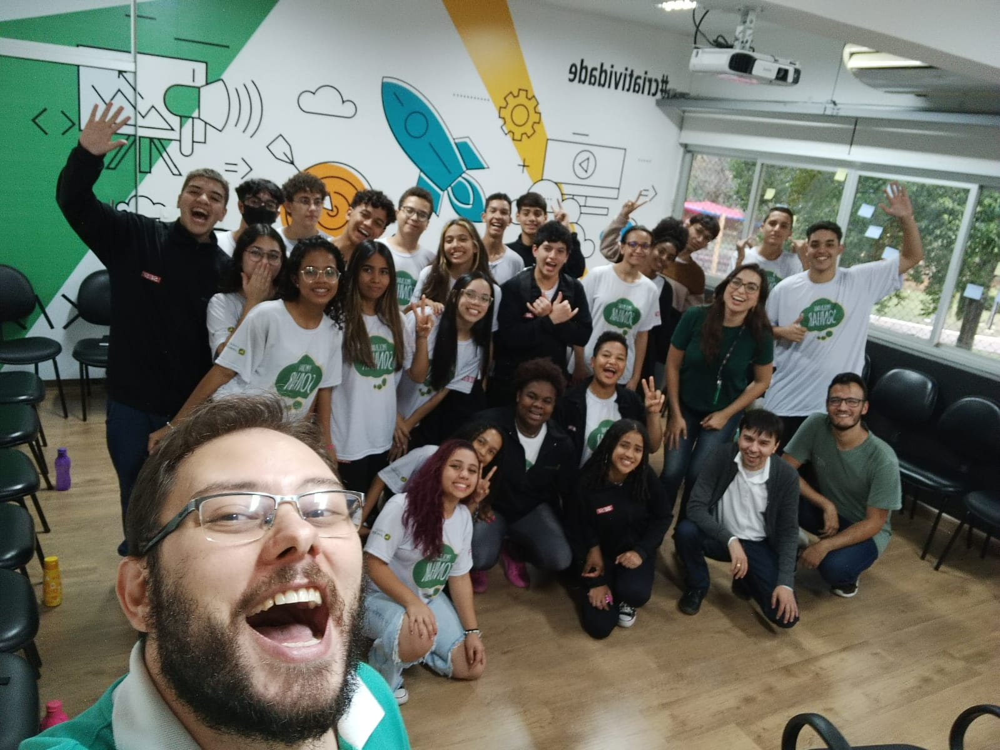

In [ ]:
imagem = Image.open("aula-1-introducao/imagens/faces-1.jpg")
imagem

In [ ]:
# nome do arquivo
file_name = "aula-1-introducao/imagens/faces-1.jpg"

# conversão para binário
with open(file_name, "rb") as file:
  img_file = file.read()
  bytes_file = bytearray(img_file)

# abrindo a sessão
session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)

# criando o cliente
client = session.client("rekognition", region_name=region)

# criando a requisição
response = client.detect_faces(
    Image={'Bytes': bytes_file},
    Attributes=["ALL"]
)

In [ ]:
response

{'FaceDetails': [{'BoundingBox': {'Width': 0.20637963712215424,
    'Height': 0.3756640553474426,
    'Left': 0.15681588649749756,
    'Top': 0.5703257322311401},
   'AgeRange': {'Low': 27, 'High': 37},
   'Smile': {'Value': True, 'Confidence': 78.45015716552734},
   'Eyeglasses': {'Value': True, 'Confidence': 99.99114990234375},
   'Sunglasses': {'Value': False, 'Confidence': 99.96205139160156},
   'Gender': {'Value': 'Male', 'Confidence': 99.93952178955078},
   'Beard': {'Value': True, 'Confidence': 99.21994018554688},
   'Mustache': {'Value': False, 'Confidence': 86.19662475585938},
   'EyesOpen': {'Value': True, 'Confidence': 97.26605987548828},
   'MouthOpen': {'Value': True, 'Confidence': 92.33683013916016},
   'Emotions': [{'Type': 'HAPPY', 'Confidence': 80.98323059082031},
    {'Type': 'SURPRISED', 'Confidence': 14.667749404907227},
    {'Type': 'FEAR', 'Confidence': 6.782601833343506},
    {'Type': 'ANGRY', 'Confidence': 2.4909274578094482},
    {'Type': 'SAD', 'Confidence': 2

Vamos analisar cada item, que é respectivo a cada face identificada.

In [ ]:
for item in response["FaceDetails"]:
  print(item)

{'BoundingBox': {'Width': 0.20637963712215424, 'Height': 0.3756640553474426, 'Left': 0.15681588649749756, 'Top': 0.5703257322311401}, 'AgeRange': {'Low': 27, 'High': 37}, 'Smile': {'Value': True, 'Confidence': 78.45015716552734}, 'Eyeglasses': {'Value': True, 'Confidence': 99.99114990234375}, 'Sunglasses': {'Value': False, 'Confidence': 99.96205139160156}, 'Gender': {'Value': 'Male', 'Confidence': 99.93952178955078}, 'Beard': {'Value': True, 'Confidence': 99.21994018554688}, 'Mustache': {'Value': False, 'Confidence': 86.19662475585938}, 'EyesOpen': {'Value': True, 'Confidence': 97.26605987548828}, 'MouthOpen': {'Value': True, 'Confidence': 92.33683013916016}, 'Emotions': [{'Type': 'HAPPY', 'Confidence': 80.98323059082031}, {'Type': 'SURPRISED', 'Confidence': 14.667749404907227}, {'Type': 'FEAR', 'Confidence': 6.782601833343506}, {'Type': 'ANGRY', 'Confidence': 2.4909274578094482}, {'Type': 'SAD', 'Confidence': 2.258896589279175}, {'Type': 'DISGUSTED', 'Confidence': 1.3579745292663574},

Cada item, representado por uma face, possui uma classificação para cada sentimento.
A função abaixo é para extrair o sentimento com maior intervalo de confiança, como sendo a predominante.

In [ ]:
# função para obter o sentimento com maior porcentagem de confiança
def obter_maior_confianca(lista):
    # inicializa a maior confiança e o dicionário com maior confiança como None
    maior_confianca = None
    dicionario_maior_confianca = None

    # percorre cada dicionário na lista
    for dicionario in lista:
        confianca = dicionario["Confidence"]

        # verifica se é a maior confiança encontrada até o momento
        if maior_confianca is None or confianca > maior_confianca:
            maior_confianca = confianca
            dicionario_maior_confianca = dicionario

    return dicionario_maior_confianca

Agora vamos analisar as faces da imagem de exemplo, obtendo o gênero identificado como também a maior emoção detectada.

In [ ]:
# ajustando tamanho da fonte
font = ImageFont.truetype("aula-1-introducao/font/arial.ttf", 20)

# selecionando a imagem
image = Image.open("aula-1-introducao/imagens/faces-1.jpg")

# obtendo tamanhos para caixa delimitadora
imgWidth, imgHeight = image.size

# inicializando imagem para anotação
draw = ImageDraw.Draw(image)

# análise de cada face
for item in response["FaceDetails"]:
    print("FaceDetail: " + str(item))
    print("Gender: " + item["Gender"]["Value"])

    emotions = item["Emotions"]

    print("Emotions: " + str(emotions))

    emotion_max = obter_maior_confianca(emotions)

    print("Maior emoção: " + str(emotion_max))

    box = item['BoundingBox']

    top = imgHeight * box['Top']
    left = imgWidth * box['Left']
    width = imgWidth * box['Width']
    height = imgHeight * box['Height']

    print('Left: ' + '{0:.0f}'.format(left))
    print('Top: ' + '{0:.0f}'.format(top))
    print('Face Width: ' + "{0:.0f}".format(width))
    print('Face Height: ' + "{0:.0f}".format(height))

    draw.rectangle([left,top, left + width, top + height], outline='#00d400')
    draw.text((left, top), item["Gender"]["Value"], font=font)
    draw.text((left, top - 20), emotion_max["Type"], font=font)


FaceDetail: {'BoundingBox': {'Width': 0.20637963712215424, 'Height': 0.3756640553474426, 'Left': 0.15681588649749756, 'Top': 0.5703257322311401}, 'AgeRange': {'Low': 27, 'High': 37}, 'Smile': {'Value': True, 'Confidence': 78.45015716552734}, 'Eyeglasses': {'Value': True, 'Confidence': 99.99114990234375}, 'Sunglasses': {'Value': False, 'Confidence': 99.96205139160156}, 'Gender': {'Value': 'Male', 'Confidence': 99.93952178955078}, 'Beard': {'Value': True, 'Confidence': 99.21994018554688}, 'Mustache': {'Value': False, 'Confidence': 86.19662475585938}, 'EyesOpen': {'Value': True, 'Confidence': 97.26605987548828}, 'MouthOpen': {'Value': True, 'Confidence': 92.33683013916016}, 'Emotions': [{'Type': 'HAPPY', 'Confidence': 80.98323059082031}, {'Type': 'SURPRISED', 'Confidence': 14.667749404907227}, {'Type': 'FEAR', 'Confidence': 6.782601833343506}, {'Type': 'ANGRY', 'Confidence': 2.4909274578094482}, {'Type': 'SAD', 'Confidence': 2.258896589279175}, {'Type': 'DISGUSTED', 'Confidence': 1.357974

Agora exibindo as caixas delimitadoras de cada face com o gênero identificado e também sua emoção.

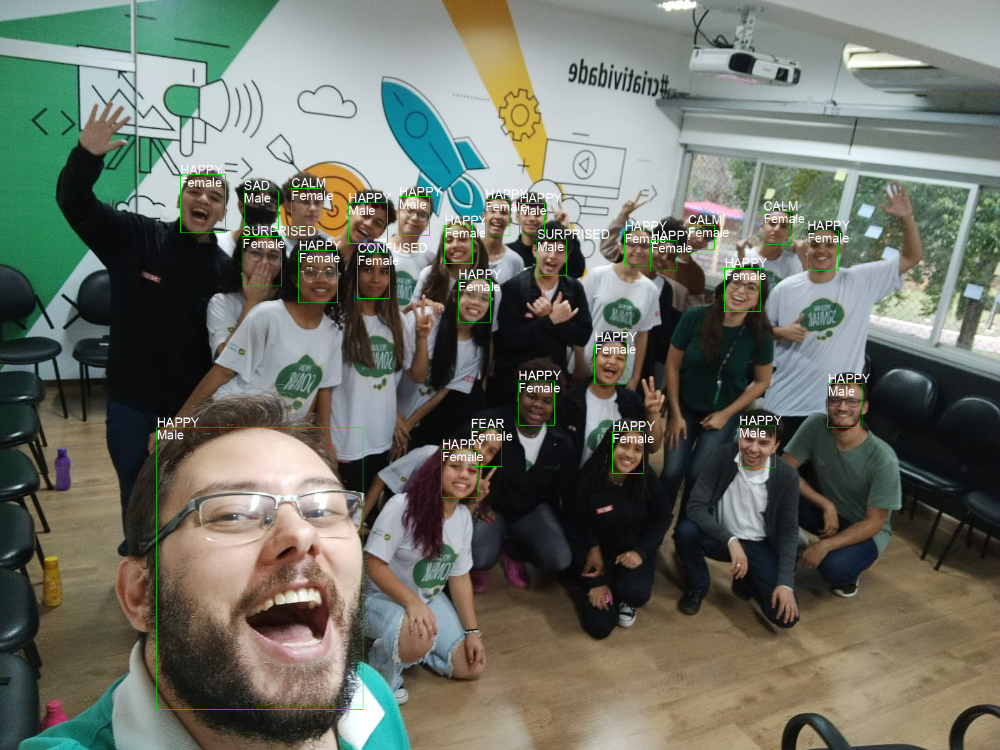

In [ ]:
image

## Comparação de faces

Esta função, conhecida também como _face match_ é capaz de comparar 2 imagens e trazer a porcentagem de similaridade entre elas.

Uma aplicação comum de segurança é validar a partir de uma imagem caputurada no instante de um on-boarding ou validação de segurança de uma aplicação junto com a imagem de um documento previamente cadastrado.

Vamos comparar a imagem de um documento, como o CNH.

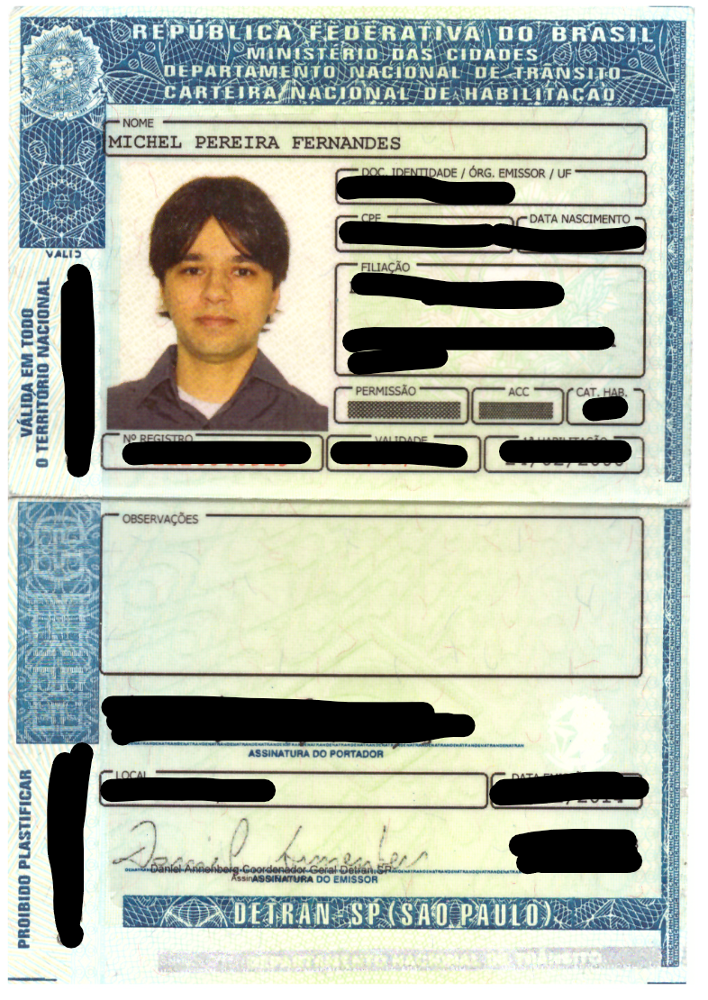

In [ ]:
imagem = Image.open("aula-1-introducao/imagens/cnh-michel.png")
imagem

Com esta outra imagem capturada em outro momento.

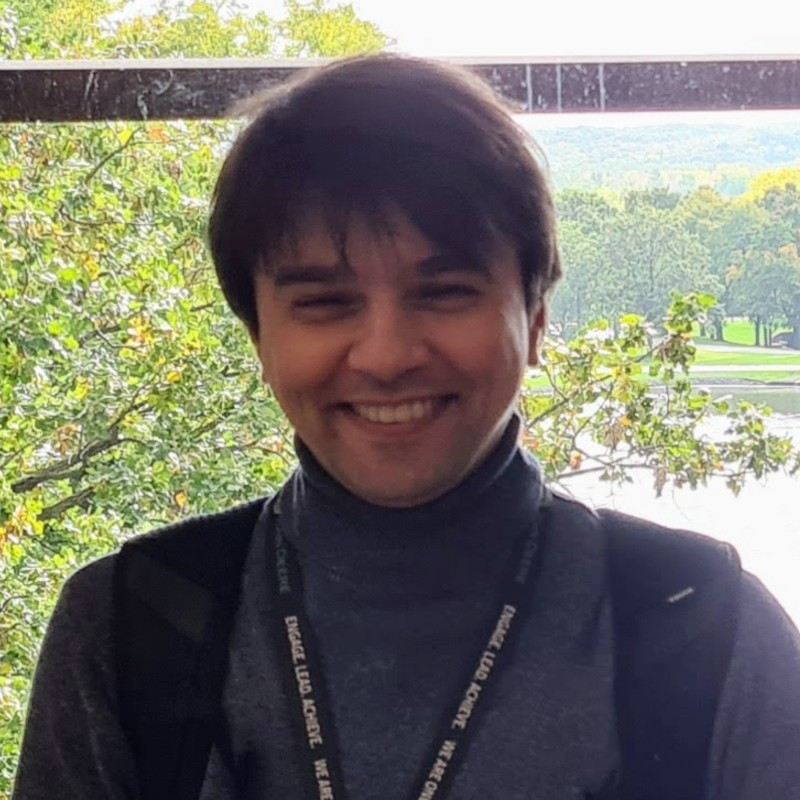

In [ ]:
imagem = Image.open("aula-1-introducao/imagens/michel-1.jpg")
imagem

In [ ]:
# imagem de comparação 1 (origem)
file_name_source = "aula-1-introducao/imagens/cnh-michel.png"

# imagem de comparação 2 (alvo)
file_name_target = "aula-1-introducao/imagens/michel-1.jpg"

# convertendo a imagem de origem no formato binário
with open(file_name_source, "rb") as file:
  img_file = file.read()
  bytes_file_source = bytearray(img_file)

# convertendo a imagem alvo no formato binário
with open(file_name_target, "rb") as file:
  img_file = file.read()
  bytes_file_target = bytearray(img_file)

# abrindo a sessão
session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)

# criando o cliente
client = session.client("rekognition", region_name=region)

# realizando a requisição
response = client.compare_faces(
    SourceImage={'Bytes': bytes_file_source},
    TargetImage={'Bytes': bytes_file_target},
)

In [ ]:
response

{'SourceImageFace': {'BoundingBox': {'Width': 0.14736957848072052,
   'Height': 0.13547378778457642,
   'Left': 0.2341586947441101,
   'Top': 0.21867385506629944},
  'Confidence': 99.99771118164062},
 'FaceMatches': [{'Similarity': 99.77592468261719,
   'Face': {'BoundingBox': {'Width': 0.33358535170555115,
     'Height': 0.3994441330432892,
     'Left': 0.320880651473999,
     'Top': 0.2238314300775528},
    'Confidence': 99.99954986572266,
    'Landmarks': [{'Type': 'eyeLeft',
      'X': 0.40618500113487244,
      'Y': 0.3734648525714874},
     {'Type': 'eyeRight', 'X': 0.5506705045700073, 'Y': 0.36284691095352173},
     {'Type': 'mouthLeft', 'X': 0.43064579367637634, 'Y': 0.5111101269721985},
     {'Type': 'mouthRight', 'X': 0.5520378351211548, 'Y': 0.5024483799934387},
     {'Type': 'nose', 'X': 0.48180511593818665, 'Y': 0.4522764980792999}],
    'Pose': {'Roll': -4.149410247802734,
     'Yaw': -2.893834352493286,
     'Pitch': -0.2870776951313019},
    'Quality': {'Brightness': 45

Com os dados do retorno temos tanto o posicionamento das faces quanto o valor de similaridade entre elas.

In [ ]:
# imagem de origem
image = Image.open("aula-1-introducao/imagens/cnh-michel.png")

# obtendo tamanho para cálculo de posicionamento
imgWidth, imgHeight = image.size

# obtendo imagem para anotação
draw = ImageDraw.Draw(image)

# obtendo a caixa delimitadora
box = response["SourceImageFace"]["BoundingBox"]

top = imgHeight * box['Top']
left = imgWidth * box['Left']
width = imgWidth * box['Width']
height = imgHeight * box['Height']

print("Left: " + "{0:.0f}".format(left))
print("Top: " + "{0:.0f}".format(top))
print("Face Width: " + "{0:.0f}".format(width))
print("Face Height: " + "{0:.0f}".format(height))

draw.rectangle([left,top, left + width, top + height], outline='#00d400')

Left: 184
Top: 243
Face Width: 116
Face Height: 150


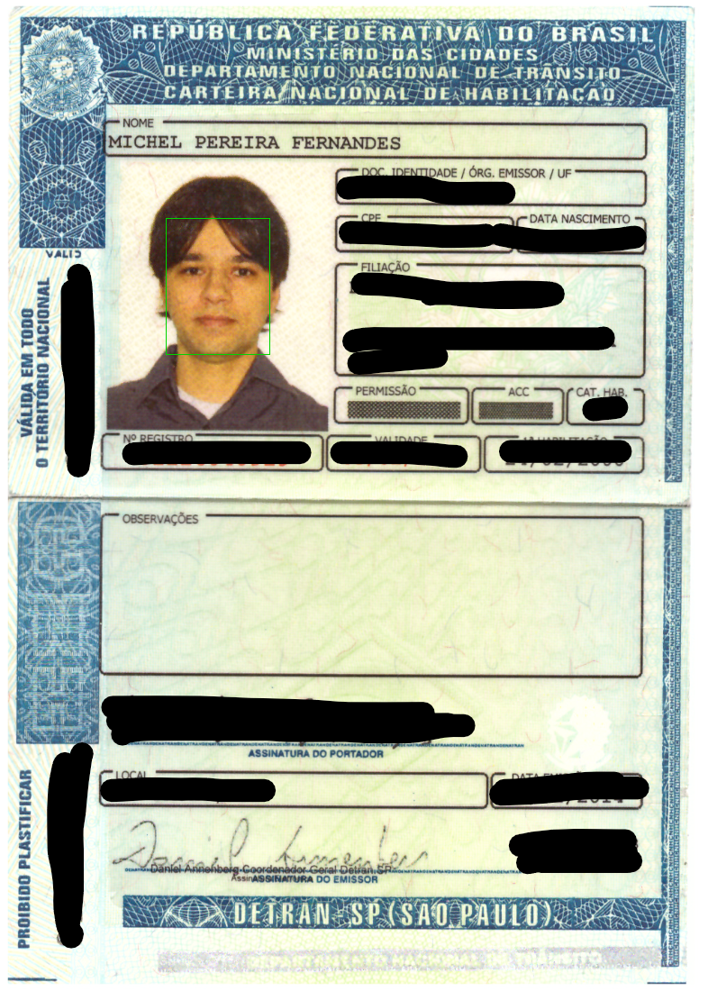

In [ ]:
image

Agora vamos analisar o componente de faces encontradas (_face matches_) para verificarmos o quanto há de similar entre as duas faces (e imagens).

In [ ]:
# ajuste de tamanho de fonte
font = ImageFont.truetype("aula-1-introducao/font/arial.ttf", 20)

# imagem alvo
image = Image.open("aula-1-introducao/imagens/michel-1.jpg")
imgWidth, imgHeight = image.size

# obtendo imagem para anotação
draw = ImageDraw.Draw(image)

# analisando cada detecção de face
for item_match in response["FaceMatches"]:
  print("Face Localizada: " + str(item_match))

  # caixa delimitadora
  box = item_match["Face"]["BoundingBox"]

  top = imgHeight * box['Top']
  left = imgWidth * box['Left']
  width = imgWidth * box['Width']
  height = imgHeight * box['Height']

  print("Left: " + "{0:.0f}".format(left))
  print("Top: " + "{0:.0f}".format(top))
  print("Face Width: " + "{0:.0f}".format(width))
  print("Face Height: " + "{0:.0f}".format(height))

  draw.rectangle([left,top, left + width, top + height], outline='#00d400')
  draw.text((left, top), "Similaridade: "+ str(item_match["Similarity"]), font=font)

  print("Similaridade: " + str(item_match["Similarity"]))

Face Localizada: {'Similarity': 99.77592468261719, 'Face': {'BoundingBox': {'Width': 0.33358535170555115, 'Height': 0.3994441330432892, 'Left': 0.320880651473999, 'Top': 0.2238314300775528}, 'Confidence': 99.99954986572266, 'Landmarks': [{'Type': 'eyeLeft', 'X': 0.40618500113487244, 'Y': 0.3734648525714874}, {'Type': 'eyeRight', 'X': 0.5506705045700073, 'Y': 0.36284691095352173}, {'Type': 'mouthLeft', 'X': 0.43064579367637634, 'Y': 0.5111101269721985}, {'Type': 'mouthRight', 'X': 0.5520378351211548, 'Y': 0.5024483799934387}, {'Type': 'nose', 'X': 0.48180511593818665, 'Y': 0.4522764980792999}], 'Pose': {'Roll': -4.149410247802734, 'Yaw': -2.893834352493286, 'Pitch': -0.2870776951313019}, 'Quality': {'Brightness': 45.62997055053711, 'Sharpness': 86.86019134521484}}}
Left: 257
Top: 179
Face Width: 267
Face Height: 320
Similaridade: 99.77592468261719


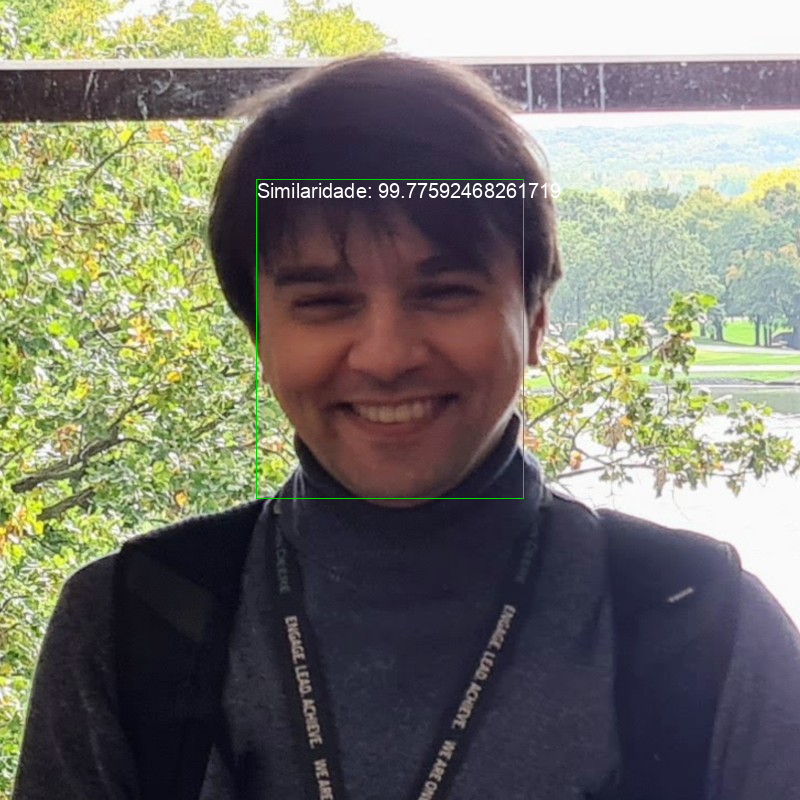

In [ ]:
image

Com similaridade acima de 90% podemos concluir que as faces são iguais.
Cada aplicação deve ter um patamar aceitável de similiradade considerando aspectos de qualidade da imagem (alvo) de captura bem como a digitalização da prova (documento).

## Reconhecimento de faces

Utiliza os mesmos mecanismos da comparação de faces para se criar uma coleção de rostos e identificá-los em outras imagens.

Cada pessoa é cadastrada com pelo menos uma imagem, no entanto com mais imagens maiores as chances de encontrar maior similaridade.

In [ ]:
# criando sessão
session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)

# abrindo cliente
client = session.client("rekognition", region_name=region)

# criando uma coleção
response = client.create_collection(
    CollectionId = "fiap-faces"
)

response

{'StatusCode': 200,
 'CollectionArn': 'aws:rekognition:us-east-1:989944764342:collection/fiap-faces',
 'FaceModelVersion': '6.0',
 'ResponseMetadata': {'RequestId': '0b097ec8-bbad-4eb3-82d3-b555d463fcb8',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amzn-requestid': '0b097ec8-bbad-4eb3-82d3-b555d463fcb8',
   'content-type': 'application/x-amz-json-1.1',
   'content-length': '122',
   'date': 'Sun, 06 Aug 2023 23:22:12 GMT'},
  'RetryAttempts': 0}}

In [ ]:
# remover uma coleção
# se for refazer a atividade
response = client.delete_collection(
    CollectionId = "michel-faces"
)

response

{'StatusCode': 200,
 'ResponseMetadata': {'RequestId': 'bac3f176-7df3-474a-bc6a-c70114b6de03',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amzn-requestid': 'bac3f176-7df3-474a-bc6a-c70114b6de03',
   'content-type': 'application/x-amz-json-1.1',
   'content-length': '18',
   'date': 'Sun, 06 Aug 2023 23:21:53 GMT'},
  'RetryAttempts': 0}}

Uma vez criado a coleção, agora criaremos um usuário/pessoa nesta coleção.
Adicionamos uma identificação para ela.

In [ ]:
# criando nova pessoa para usar como identidade
response = client.create_user(
    CollectionId='fiap-faces',
    UserId='michel-fernandes'
)

response

{'ResponseMetadata': {'RequestId': '6b4edad5-9347-400d-88e0-11ee578d84c6',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amzn-requestid': '6b4edad5-9347-400d-88e0-11ee578d84c6',
   'content-type': 'application/x-amz-json-1.1',
   'content-length': '2',
   'date': 'Sun, 06 Aug 2023 23:22:58 GMT'},
  'RetryAttempts': 0}}

In [ ]:
# remover pessoa
# para refazer a identidade
response = client.delete_user(
    CollectionId='michel-faces',
    UserId='1'
)

response

{'ResponseMetadata': {'RequestId': '2100764b-fd9a-410e-a4b6-0fdea4beadca',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amzn-requestid': '2100764b-fd9a-410e-a4b6-0fdea4beadca',
   'content-type': 'application/x-amz-json-1.1',
   'content-length': '2',
   'date': 'Sun, 06 Aug 2023 23:21:09 GMT'},
  'RetryAttempts': 0}}

Agora vamos adicionar 5 faces.
Note que as faces são adicionadas à coleção e somente depois associaremos a um determinado usuário.


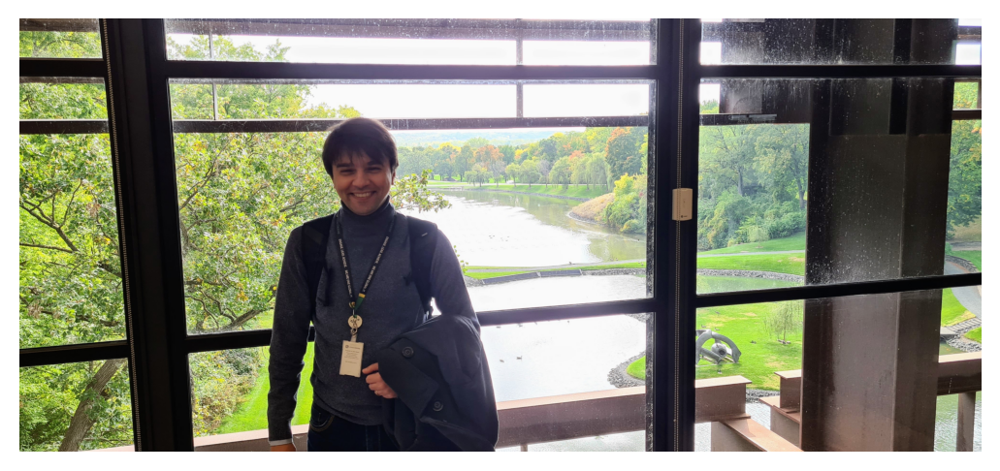

In [ ]:
img = mpimg.imread("aula-1-introducao/imagens/michel-face-1.jpg")
imgplot = plt.imshow(img)

plt.axis('off')
plt.show()

In [ ]:
# adicionando face 1

# identificação do bucket
bucket_name = "fiap-cognitive-platforms"
# identificação do arquivo
file_name = "faces/michel/michel-face-1.jpg"

response = client.index_faces(
    CollectionId='fiap-faces',
    Image={
        'S3Object': {
            'Bucket': bucket_name,
            'Name': file_name
        }
    }
)

response

{'FaceRecords': [{'Face': {'FaceId': 'e83e5d07-620c-42fe-b887-c87edf276e5e',
    'BoundingBox': {'Width': 0.06068820133805275,
     'Height': 0.15988369286060333,
     'Left': 0.3239020109176636,
     'Top': 0.29020217061042786},
    'ImageId': 'be2b4636-bf0e-3ca7-b8eb-3d4763abc069',
    'Confidence': 99.989990234375},
   'FaceDetail': {'BoundingBox': {'Width': 0.06068820133805275,
     'Height': 0.15988369286060333,
     'Left': 0.3239020109176636,
     'Top': 0.29020217061042786},
    'Landmarks': [{'Type': 'eyeLeft',
      'X': 0.3408876955509186,
      'Y': 0.35033658146858215},
     {'Type': 'eyeRight', 'X': 0.3666093647480011, 'Y': 0.34615638852119446},
     {'Type': 'mouthLeft', 'X': 0.3451137840747833, 'Y': 0.4046444594860077},
     {'Type': 'mouthRight', 'X': 0.3667290508747101, 'Y': 0.4012739658355713},
     {'Type': 'nose', 'X': 0.35415777564048767, 'Y': 0.3814825415611267}],
    'Pose': {'Roll': -4.521045684814453,
     'Yaw': -3.0004658699035645,
     'Pitch': -1.082196712

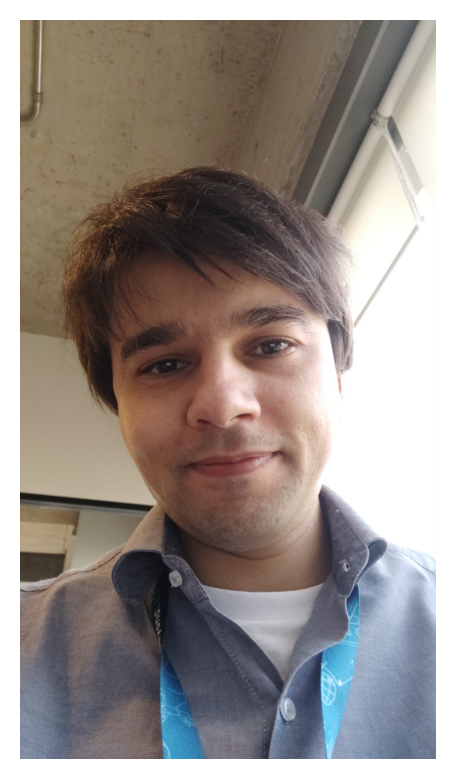

In [ ]:
img = mpimg.imread("aula-1-introducao/imagens/michel-face-2.jpeg")
imgplot = plt.imshow(img)

plt.axis('off')
plt.show()

In [ ]:
bucket_name = "fiap-cognitive-platforms"
file_name = "faces/michel/michel-face-2.jpeg"

response = client.index_faces(
    CollectionId='fiap-faces',
    Image={
        'S3Object': {
            'Bucket': bucket_name,
            'Name': file_name
        }
    }
)

response

{'FaceRecords': [{'Face': {'FaceId': '2cc76cfb-7e16-4812-8099-47ebd9482985',
    'BoundingBox': {'Width': 0.5389995574951172,
     'Height': 0.41245758533477783,
     'Left': 0.21515774726867676,
     'Top': 0.2981119751930237},
    'ImageId': '99683268-9be7-37e5-9f74-f7150b67d592',
    'Confidence': 99.99968719482422},
   'FaceDetail': {'BoundingBox': {'Width': 0.5389995574951172,
     'Height': 0.41245758533477783,
     'Left': 0.21515774726867676,
     'Top': 0.2981119751930237},
    'Landmarks': [{'Type': 'eyeLeft',
      'X': 0.35040083527565,
      'Y': 0.4626360535621643},
     {'Type': 'eyeRight', 'X': 0.5900247693061829, 'Y': 0.4410586655139923},
     {'Type': 'mouthLeft', 'X': 0.4078022837638855, 'Y': 0.6022605299949646},
     {'Type': 'mouthRight', 'X': 0.6079530715942383, 'Y': 0.5844056606292725},
     {'Type': 'nose', 'X': 0.48059460520744324, 'Y': 0.5252916216850281}],
    'Pose': {'Roll': -9.908652305603027,
     'Yaw': -1.771820068359375,
     'Pitch': 5.435396671295166

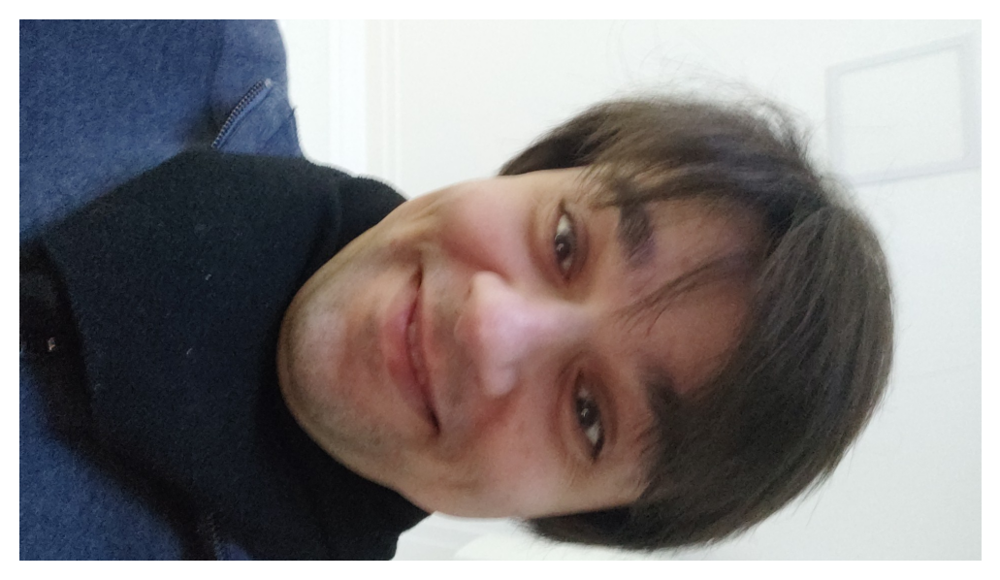

In [ ]:
# esta imagem é renderizada rotacionada, mas originalmente está com a orientação adequada
# abra ela pelo Colab para conferir

img = mpimg.imread("aula-1-introducao/imagens/michel-face-3.jpeg")
imgplot = plt.imshow(img)

plt.axis('off')
plt.show()

In [ ]:
bucket_name = "fiap-cognitive-platforms"
file_name = "faces/michel/michel-face-3.jpeg"

response = client.index_faces(
    CollectionId='fiap-faces',
    Image={
        'S3Object': {
            'Bucket': bucket_name,
            'Name': file_name
        }
    }
)

response

{'FaceRecords': [{'Face': {'FaceId': 'a49e52af-d8d2-4e46-8984-92b29555a299',
    'BoundingBox': {'Width': 0.6612038016319275,
     'Height': 0.5087642073631287,
     'Left': 0.2659233808517456,
     'Top': 0.2155490517616272},
    'ImageId': '9b1c8b23-cd06-3085-b66a-cdd84e6244e3',
    'Confidence': 99.9996566772461},
   'FaceDetail': {'BoundingBox': {'Width': 0.6612038016319275,
     'Height': 0.5087642073631287,
     'Left': 0.2659233808517456,
     'Top': 0.2155490517616272},
    'Landmarks': [{'Type': 'eyeLeft',
      'X': 0.41844087839126587,
      'Y': 0.42316195368766785},
     {'Type': 'eyeRight', 'X': 0.7141994833946228, 'Y': 0.40372100472450256},
     {'Type': 'mouthLeft', 'X': 0.4801441431045532, 'Y': 0.5855655670166016},
     {'Type': 'mouthRight', 'X': 0.7277610898017883, 'Y': 0.5696563720703125},
     {'Type': 'nose', 'X': 0.5685353875160217, 'Y': 0.5085734128952026}],
    'Pose': {'Roll': -7.137189865112305,
     'Yaw': -3.6373589038848877,
     'Pitch': -0.44797995686531

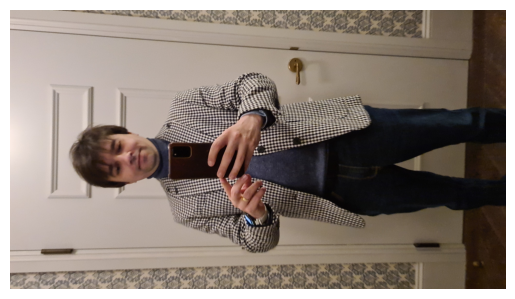

In [ ]:
# esta imagem é renderizada rotacionada, mas originalmente está com a orientação adequada
# abra ela pelo Colab para conferir

img = mpimg.imread("aula-1-introducao/imagens/michel-face-4.jpeg")
imgplot = plt.imshow(img)

plt.axis('off')
plt.show()

In [ ]:
bucket_name = "fiap-cognitive-platforms"
file_name = "faces/michel/michel-face-4.jpeg"

response = client.index_faces(
    CollectionId='fiap-faces',
    Image={
        'S3Object': {
            'Bucket': bucket_name,
            'Name': file_name
        }
    }
)

response

{'FaceRecords': [{'Face': {'FaceId': '78041e1c-ceb3-4ac1-8e39-10c3de1c7b3b',
    'BoundingBox': {'Width': 0.17435351014137268,
     'Height': 0.12009265273809433,
     'Left': 0.38289767503738403,
     'Top': 0.17252515256404877},
    'ImageId': '291d95be-d0a0-3b2b-a1ee-73e58b8f84d8',
    'Confidence': 99.99044036865234},
   'FaceDetail': {'BoundingBox': {'Width': 0.17435351014137268,
     'Height': 0.12009265273809433,
     'Left': 0.38289767503738403,
     'Top': 0.17252515256404877},
    'Landmarks': [{'Type': 'eyeLeft',
      'X': 0.4316582679748535,
      'Y': 0.21654988825321198},
     {'Type': 'eyeRight', 'X': 0.5049667954444885, 'Y': 0.21894940733909607},
     {'Type': 'mouthLeft', 'X': 0.43423107266426086, 'Y': 0.2598397433757782},
     {'Type': 'mouthRight',
      'X': 0.49536946415901184,
      'Y': 0.26183730363845825},
     {'Type': 'nose', 'X': 0.46572157740592957, 'Y': 0.23880518972873688}],
    'Pose': {'Roll': 1.8307061195373535,
     'Yaw': -0.46365979313850403,
     

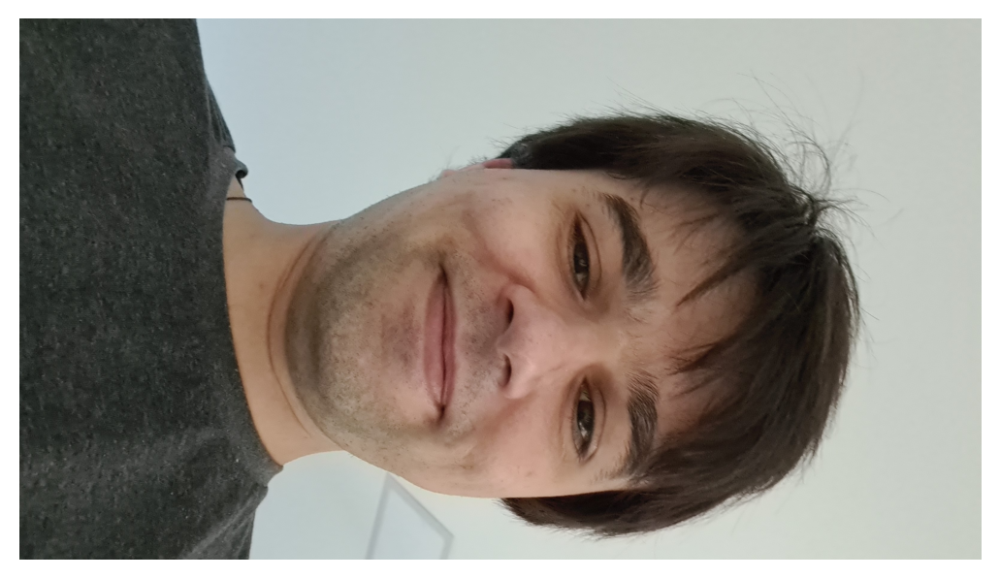

In [ ]:
# esta imagem é renderizada rotacionada, mas originalmente está com a orientação adequada
# abra ela pelo Colab para conferir

img = mpimg.imread("aula-1-introducao/imagens/michel-face-5.jpeg")
imgplot = plt.imshow(img)

plt.axis('off')
plt.show()

In [ ]:
bucket_name = "fiap-cognitive-platforms"
file_name = "faces/michel/michel-face-5.jpeg"

response = client.index_faces(
    CollectionId='fiap-faces',
    Image={
        'S3Object': {
            'Bucket': bucket_name,
            'Name': file_name
        }
    }
)

response

{'FaceRecords': [{'Face': {'FaceId': '7de5b11f-8756-4ed8-ae29-9b5c6c434ad5',
    'BoundingBox': {'Width': 0.6120060682296753,
     'Height': 0.45759591460227966,
     'Left': 0.27334752678871155,
     'Top': 0.2237718105316162},
    'ImageId': 'c4564d26-c117-3e5c-85c9-f795db4375af',
    'Confidence': 99.99971008300781},
   'FaceDetail': {'BoundingBox': {'Width': 0.6120060682296753,
     'Height': 0.45759591460227966,
     'Left': 0.27334752678871155,
     'Top': 0.2237718105316162},
    'Landmarks': [{'Type': 'eyeLeft',
      'X': 0.4496874511241913,
      'Y': 0.4072614908218384},
     {'Type': 'eyeRight', 'X': 0.7308389544487, 'Y': 0.4041254222393036},
     {'Type': 'mouthLeft', 'X': 0.4796163737773895, 'Y': 0.5615748763084412},
     {'Type': 'mouthRight', 'X': 0.7137072682380676, 'Y': 0.5588380098342896},
     {'Type': 'nose', 'X': 0.6000646352767944, 'Y': 0.4714546203613281}],
    'Pose': {'Roll': -1.0612090826034546,
     'Yaw': 1.4671496152877808,
     'Pitch': 14.016335487365723

Associar faces na coleção e na lista de faces (todas as 5).

In [ ]:
response = client.associate_faces(
            CollectionId="fiap-faces",
            UserId="michel-fernandes",
            FaceIds=["e83e5d07-620c-42fe-b887-c87edf276e5e", "2cc76cfb-7e16-4812-8099-47ebd9482985", "78041e1c-ceb3-4ac1-8e39-10c3de1c7b3b", "78041e1c-ceb3-4ac1-8e39-10c3de1c7b3b", "7de5b11f-8756-4ed8-ae29-9b5c6c434ad5"]
)

response

{'AssociatedFaces': [{'FaceId': 'e83e5d07-620c-42fe-b887-c87edf276e5e'},
  {'FaceId': '2cc76cfb-7e16-4812-8099-47ebd9482985'},
  {'FaceId': '78041e1c-ceb3-4ac1-8e39-10c3de1c7b3b'},
  {'FaceId': '7de5b11f-8756-4ed8-ae29-9b5c6c434ad5'}],
 'UnsuccessfulFaceAssociations': [],
 'UserStatus': 'UPDATING',
 'ResponseMetadata': {'RequestId': '683d592c-eac8-49b6-9d86-e31510992ac3',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amzn-requestid': '683d592c-eac8-49b6-9d86-e31510992ac3',
   'content-type': 'application/x-amz-json-1.1',
   'content-length': '279',
   'date': 'Sun, 06 Aug 2023 23:26:46 GMT'},
  'RetryAttempts': 0}}

Confirmando que as faces estão associadas ao _UserId_ informado.

In [ ]:
response = client.list_faces(CollectionId="fiap-faces")
response

{'Faces': [{'FaceId': '2cc76cfb-7e16-4812-8099-47ebd9482985',
   'BoundingBox': {'Width': 0.5389999747276306,
    'Height': 0.41245800256729126,
    'Left': 0.21515800058841705,
    'Top': 0.29811200499534607},
   'ImageId': '99683268-9be7-37e5-9f74-f7150b67d592',
   'Confidence': 99.99970245361328,
   'IndexFacesModelVersion': '6.0',
   'UserId': 'michel-fernandes'},
  {'FaceId': '78041e1c-ceb3-4ac1-8e39-10c3de1c7b3b',
   'BoundingBox': {'Width': 0.17435400187969208,
    'Height': 0.12009300291538239,
    'Left': 0.3828980028629303,
    'Top': 0.17252500355243683},
   'ImageId': '291d95be-d0a0-3b2b-a1ee-73e58b8f84d8',
   'Confidence': 99.99039459228516,
   'IndexFacesModelVersion': '6.0',
   'UserId': 'michel-fernandes'},
  {'FaceId': '7de5b11f-8756-4ed8-ae29-9b5c6c434ad5',
   'BoundingBox': {'Width': 0.6120060086250305,
    'Height': 0.4575960040092468,
    'Left': 0.27334800362586975,
    'Top': 0.22377200424671173},
   'ImageId': 'c4564d26-c117-3e5c-85c9-f795db4375af',
   'Confiden

In [ ]:
# remover faces
# caso queira refazer a atividade
response = client.delete_faces(
    CollectionId='michel-faces',
    FaceIds=["d847f088-ae6c-4bc0-abd9-66a0ed72f996"]
)

response

{'DeletedFaces': ['d847f088-ae6c-4bc0-abd9-66a0ed72f996'],
 'UnsuccessfulFaceDeletions': [],
 'ResponseMetadata': {'RequestId': '9f3348b7-9781-4384-adcf-a485fbe7f9a1',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amzn-requestid': '9f3348b7-9781-4384-adcf-a485fbe7f9a1',
   'content-type': 'application/x-amz-json-1.1',
   'content-length': '88',
   'date': 'Mon, 31 Jul 2023 23:58:41 GMT'},
  'RetryAttempts': 0}}

Tendo as faces mapeadas e treinadas, vamos realizar o reconhecimento de uma face.

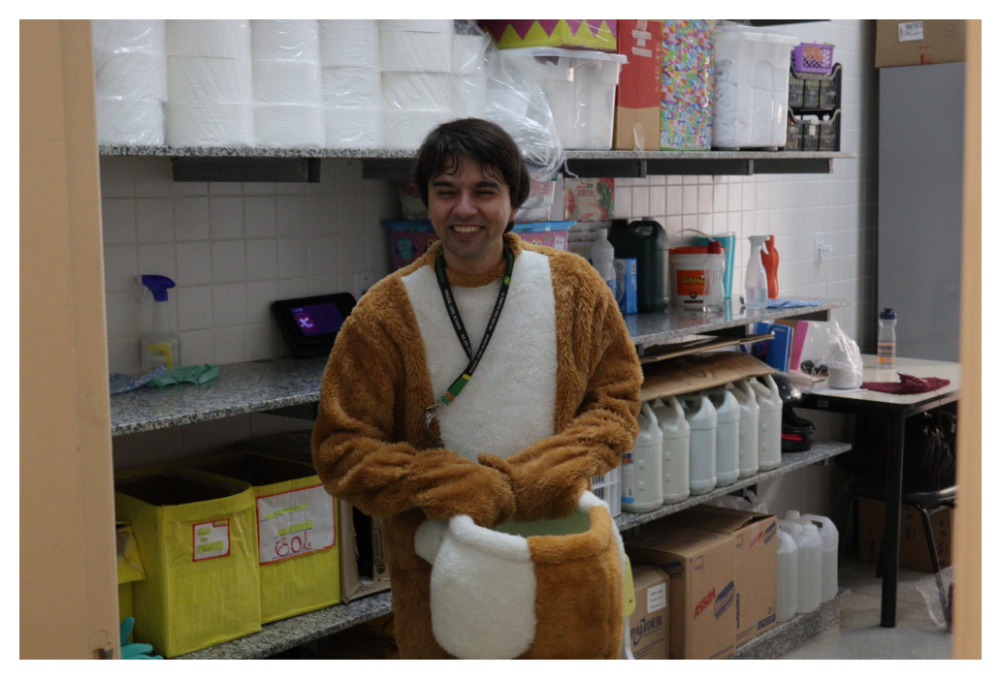

In [ ]:
img = mpimg.imread("aula-1-introducao/imagens/michel-2.jpg")
imgplot = plt.imshow(img)

plt.axis('off')
plt.show()

In [ ]:
# caminho do arquivo local
file_name_source = "aula-1-introducao/imagens/michel-2.jpg"

# convertendo para binário
with open(file_name_source, "rb") as file:
  img_file = file.read()
  bytes_file_source = bytearray(img_file)

# abrindo a sessão
session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)

# criando cliente
client = session.client("rekognition", region_name=region)

# enviando a requisição com a imgem local
response = client.search_faces_by_image(
    Image={'Bytes': bytes_file_source},
    CollectionId='fiap-faces'
)

In [ ]:
response

{'SearchedFaceBoundingBox': {'Width': 0.08660564571619034,
  'Height': 0.1640600711107254,
  'Left': 0.4237428903579712,
  'Top': 0.21024146676063538},
 'SearchedFaceConfidence': 99.9974594116211,
 'FaceMatches': [{'Similarity': 99.99769592285156,
   'Face': {'FaceId': 'e83e5d07-620c-42fe-b887-c87edf276e5e',
    'BoundingBox': {'Width': 0.06068820133805275,
     'Height': 0.1598840057849884,
     'Left': 0.3239020109176636,
     'Top': 0.29020199179649353},
    'ImageId': 'be2b4636-bf0e-3ca7-b8eb-3d4763abc069',
    'Confidence': 99.98999786376953,
    'IndexFacesModelVersion': '6.0'}},
  {'Similarity': 99.99230194091797,
   'Face': {'FaceId': '78041e1c-ceb3-4ac1-8e39-10c3de1c7b3b',
    'BoundingBox': {'Width': 0.17435400187969208,
     'Height': 0.12009300291538239,
     'Left': 0.3828980028629303,
     'Top': 0.17252500355243683},
    'ImageId': '291d95be-d0a0-3b2b-a1ee-73e58b8f84d8',
    'Confidence': 99.99039459228516,
    'IndexFacesModelVersion': '6.0'}},
  {'Similarity': 99.96699

Analisando as imagens com similaridade. Note que apesar de termos 5 imagens cadastradas, somente 4 foram identificadas.

In [ ]:
for item in response["FaceMatches"]:
  print(item)

{'Similarity': 99.99769592285156, 'Face': {'FaceId': 'e83e5d07-620c-42fe-b887-c87edf276e5e', 'BoundingBox': {'Width': 0.06068820133805275, 'Height': 0.1598840057849884, 'Left': 0.3239020109176636, 'Top': 0.29020199179649353}, 'ImageId': 'be2b4636-bf0e-3ca7-b8eb-3d4763abc069', 'Confidence': 99.98999786376953, 'IndexFacesModelVersion': '6.0'}}
{'Similarity': 99.99230194091797, 'Face': {'FaceId': '78041e1c-ceb3-4ac1-8e39-10c3de1c7b3b', 'BoundingBox': {'Width': 0.17435400187969208, 'Height': 0.12009300291538239, 'Left': 0.3828980028629303, 'Top': 0.17252500355243683}, 'ImageId': '291d95be-d0a0-3b2b-a1ee-73e58b8f84d8', 'Confidence': 99.99039459228516, 'IndexFacesModelVersion': '6.0'}}
{'Similarity': 99.96699523925781, 'Face': {'FaceId': '2cc76cfb-7e16-4812-8099-47ebd9482985', 'BoundingBox': {'Width': 0.5389999747276306, 'Height': 0.41245800256729126, 'Left': 0.21515800058841705, 'Top': 0.29811200499534607}, 'ImageId': '99683268-9be7-37e5-9f74-f7150b67d592', 'Confidence': 99.99970245361328, 

Com isso, vamos buscar a face com maior similiridade, pois a identificação do usuário (_UserId_) é associado com uma identificação de face (_FaceId_)

In [ ]:
# definindo tamanho da fonte
font = ImageFont.truetype("aula-1-introducao/font/arial.ttf", 20)

# abrindo imagem para anotação
image = Image.open("aula-1-introducao/imagens/michel-2.jpg")
imgWidth, imgHeight = image.size

# preparando imagem para anotação
draw = ImageDraw.Draw(image)

# definindo variáveis para controle de similariade máxima
max_similarity = None
face_id_max_similarity = None

# buscando as imagens com similaridade
for item_match in response["FaceMatches"]:
  print(item_match)

  # filtrando as com a maior similaridade
  # ficaremos apenas com a máxima
  if max_similarity is None or item_match["Similarity"] > max_similarity:
    max_similarity = item_match["Similarity"]
    face_id_max_similarity = item_match["Face"]["FaceId"]
    print("Face com similiraridade superior")
  else:
    print("Face com similaridade inferior.")
    continue

  # obtendo a caixa delimitadora
  box = response["SearchedFaceBoundingBox"]

  top = imgHeight * box['Top']
  left = imgWidth * box['Left']
  width = imgWidth * box['Width']
  height = imgHeight * box['Height']

  print('Left: ' + '{0:.0f}'.format(left))
  print('Top: ' + '{0:.0f}'.format(top))
  print('Face Width: ' + "{0:.0f}".format(width))
  print('Face Height: ' + "{0:.0f}".format(height))

  draw.rectangle([left, top, left + width, top + height], outline='#00d400')

{'Similarity': 99.99769592285156, 'Face': {'FaceId': 'e83e5d07-620c-42fe-b887-c87edf276e5e', 'BoundingBox': {'Width': 0.06068820133805275, 'Height': 0.1598840057849884, 'Left': 0.3239020109176636, 'Top': 0.29020199179649353}, 'ImageId': 'be2b4636-bf0e-3ca7-b8eb-3d4763abc069', 'Confidence': 99.98999786376953, 'IndexFacesModelVersion': '6.0'}}
Face com similiraridade superior
Left: 686
Top: 227
Face Width: 140
Face Height: 177
{'Similarity': 99.99230194091797, 'Face': {'FaceId': '78041e1c-ceb3-4ac1-8e39-10c3de1c7b3b', 'BoundingBox': {'Width': 0.17435400187969208, 'Height': 0.12009300291538239, 'Left': 0.3828980028629303, 'Top': 0.17252500355243683}, 'ImageId': '291d95be-d0a0-3b2b-a1ee-73e58b8f84d8', 'Confidence': 99.99039459228516, 'IndexFacesModelVersion': '6.0'}}
Face com similaridade inferior.
{'Similarity': 99.96699523925781, 'Face': {'FaceId': '2cc76cfb-7e16-4812-8099-47ebd9482985', 'BoundingBox': {'Width': 0.5389999747276306, 'Height': 0.41245800256729126, 'Left': 0.215158000588417

Buscando, a partir do id de face (_FaceId_), com maior similaridade, qual usuário (_UserId_) está associado.

In [ ]:
response = client.search_users(
    FaceId=face_id_max_similarity,
    CollectionId='fiap-faces'
)

response

{'UserMatches': [{'Similarity': 99.99992370605469,
   'User': {'UserId': 'michel-fernandes', 'UserStatus': 'ACTIVE'}}],
 'FaceModelVersion': '6',
 'SearchedFace': {'FaceId': 'e83e5d07-620c-42fe-b887-c87edf276e5e'},
 'ResponseMetadata': {'RequestId': '5e5e48ca-2c43-4f0a-95b6-0c092bc86d19',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amzn-requestid': '5e5e48ca-2c43-4f0a-95b6-0c092bc86d19',
   'content-type': 'application/x-amz-json-1.1',
   'content-length': '197',
   'date': 'Sun, 06 Aug 2023 23:43:48 GMT'},
  'RetryAttempts': 0}}

In [ ]:
# usuários com similaridade
users_matched = []

# buscando cada usuário
for item in response["UserMatches"]:
  print(item)
  # similaridade encontrada
  similaridade = str(item["Similarity"])
  # usuário identificado
  user = item["User"]["UserId"]
  print("Similaridade: " + similaridade)
  print("User: " + user)

{'Similarity': 99.99992370605469, 'User': {'UserId': 'michel-fernandes', 'UserStatus': 'ACTIVE'}}
Similaridade: 99.99992370605469
User: michel-fernandes


In [ ]:
draw.text((left, top-30), "Similaridade: " + similaridade, font=font)
draw.text((left, top-60), "Identidade: " + user, font=font)

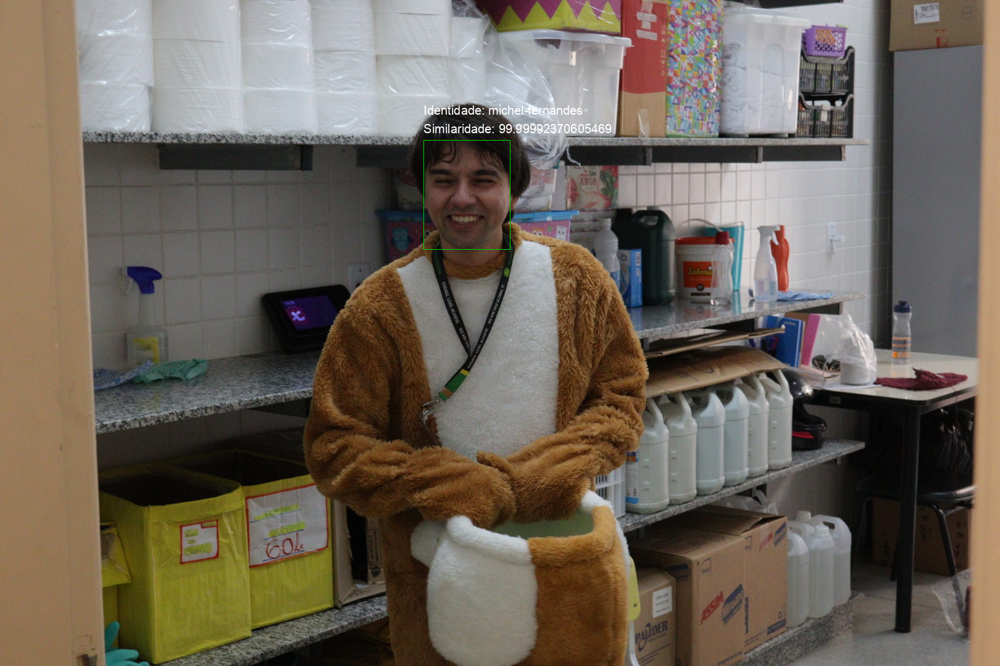

In [ ]:
 image

## Análise de vídeo

De maneira similar a análise ou descrição de cena, abordado anteriormente, podemos utilizar ao invés de imagens estáticas utilizar vídeos.

Na prática a execução é a mesma, voltada para cada frame (ou imagem) do vídeo.

Como arquivos de vídeo são maiores, nesse tipo de requisição é feita diretamente pelo bucket do S3.

In [ ]:
# identificação do bucket
bucket_name = "fiap-cognitive-platforms"
# identificação do arquivo (incluindo pasta e subpastas)
file_name = "video/family.mp4"

# abrindo a sessão
session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)

#criando cliente
client = session.client("rekognition", region_name=region)

response = client.start_label_detection(
    Video={
        'S3Object': {
            'Bucket': bucket_name,
            'Name': file_name
        },
    }
)

A análise não é imediata, por isso a resposta é indicada qual o _Job_ está sendo responsável pela execução.

In [ ]:
response

{'JobId': 'db6b974709b0ae5970ea09582981bdda9872466eea473df502ee7da4dcbe5848',
 'ResponseMetadata': {'RequestId': '519fbd7a-cec2-46d9-8090-44904d852d96',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amzn-requestid': '519fbd7a-cec2-46d9-8090-44904d852d96',
   'content-type': 'application/x-amz-json-1.1',
   'content-length': '76',
   'date': 'Sun, 06 Aug 2023 22:59:59 GMT'},
  'RetryAttempts': 0}}

Com a função abaixo obtemos os resultados a partir do ```JobId```.

In [ ]:
response = client.get_label_detection(
    JobId='db6b974709b0ae5970ea09582981bdda9872466eea473df502ee7da4dcbe5848'
)

response

{'JobStatus': 'SUCCEEDED',
 'VideoMetadata': {'Codec': 'h264',
  'DurationMillis': 7415,
  'Format': 'QuickTime / MOV',
  'FrameRate': 59.87440872192383,
  'FrameHeight': 2160,
  'FrameWidth': 3840,
  'ColorRange': 'LIMITED'},
 'Labels': [{'Timestamp': 0,
   'Label': {'Name': 'Adult',
    'Confidence': 98.12693786621094,
    'Instances': [{'BoundingBox': {'Width': 0.21660569310188293,
       'Height': 0.9584853649139404,
       'Left': 0.4370284974575043,
       'Top': 0.0313103049993515},
      'Confidence': 97.94374084472656}],
    'Parents': [{'Name': 'Person'}],
    'Aliases': [],
    'Categories': [{'Name': 'Person Description'}]}},
  {'Timestamp': 0,
   'Label': {'Name': 'Basketball',
    'Confidence': 51.031524658203125,
    'Instances': [],
    'Parents': [{'Name': 'Sport'}],
    'Aliases': [],
    'Categories': [{'Name': 'Sports'}]}},
  {'Timestamp': 0,
   'Label': {'Name': 'Body Part',
    'Confidence': 54.87936019897461,
    'Instances': [],
    'Parents': [],
    'Aliases':

Analisando cada item da resposta, temos mais interesse nos objetos representado por _Labels_.

In [ ]:
for item in response:
  print(item)

JobStatus
VideoMetadata
Labels
LabelModelVersion
JobId
Video
GetRequestMetadata
ResponseMetadata


Exibindo todos os objetos detectados.

In [ ]:
for item in response["Labels"]:
  print("Label: " + item["Label"]["Name"])
  print("Confidence: " + str(item["Label"]["Confidence"]))

Label: Adult
Confidence: 98.12693786621094
Label: Basketball
Confidence: 51.031524658203125
Label: Body Part
Confidence: 54.87936019897461
Label: Child
Confidence: 99.10458374023438
Label: City
Confidence: 52.56367111206055
Label: Clothing
Confidence: 98.16255950927734
Label: Female
Confidence: 99.14474487304688
Label: Footwear
Confidence: 98.1280288696289
Label: Girl
Confidence: 99.10458374023438
Label: Grass
Confidence: 55.901309967041016
Label: Hand
Confidence: 54.87936019897461
Label: Helmet
Confidence: 98.56575775146484
Label: Holding Hands
Confidence: 52.20096969604492
Label: Ice Skating
Confidence: 50.69902038574219
Label: Ice Skating Dancing
Confidence: 50.69902038574219
Label: Nature
Confidence: 55.901309967041016
Label: Outdoors
Confidence: 61.285762786865234
Label: Park
Confidence: 55.901309967041016
Label: Path
Confidence: 55.79682159423828
Label: Pedestrian
Confidence: 53.430728912353516
Label: People
Confidence: 51.01622772216797
Label: Performer
Confidence: 50.6990203857

Listando objetos com confiança maior que 80%.

In [ ]:
for item in response["Labels"]:
  # filtrando objetos com confiança acima 80%
  if item["Label"]["Confidence"] > 0.8:
    print(item["Label"]["Name"])

Adult
Basketball
Body Part
Child
City
Clothing
Female
Footwear
Girl
Grass
Hand
Helmet
Holding Hands
Ice Skating
Ice Skating Dancing
Nature
Outdoors
Park
Path
Pedestrian
People
Performer
Person
Plant
Playing Basketball
Rink
Road
Roller Skating
Running
Shoe
Shorts
Skating
Sport
Street
Summer
Trail
Tree
Urban
Vegetation
Walking
Woman
Working Out
Adult
Advertisement
Body Part
Child
City
Clothing
Female
Footwear
Girl
Grass
Hand
Hat
Helmet
Holding Hands
Nature
Outdoors
Palm Tree
Park
Path
Pedestrian
People
Person
Plant
Poster
Road
Roller Skating
Running
Shoe
Shorts
Skating
Skirt
Sport
Street
Tree
Urban
Vegetation
Walking
Woman
Adult
Advertisement
Body Part
Child
City
Clothing
Female
Footwear
Girl
Glove
Grass
Hand
Hat
Helmet
Holding Hands
Nature
Outdoors
Park
Path
Pedestrian
People
Person
Plant
Poster
Racket
Road
Roller Skating
Running
Shoe
Shorts
Skating
Sport
Street
Urban
Walking
Woman
Accessories
Adult
Advertisement
Body Part
Child
City
Clothing
Female
Footwear
Girl
Glove
Grass
Hand
Hat
He

# Amazon Comprehend

Serviço de processamento de linguagem natural (NLP) capaz de realizar as seguintes funções:

*   Detecção de entidades
*   Frases principais
*   Detecção de idioma
*   PII (_Personally Identifiable Information_)
*   Análise de sentimentos

Também é possível criar modelos customizados para identificação de classes ou novas entidades.

O treino de entidades tem o objetivo de utilizar em deteção de formulários específicos ou tipos de dados específicos.

Consulte [documentação](https://docs.aws.amazon.com/comprehend/index.html).



## Deteção de entidades

Vamos realizar um teste com o seguinte texto:

"_Se depender do bilionário Elon Musk, a luta contra Mark Zuckerberg (CEO da Meta, que controla o Instagram, WhatsApp e Facebook) está em pé e ainda haverá transmissão ao vivo do evento. Em publicação neste domingo (6), Musk disse que o embate será transmitido na rede social X (anteriormente conhecida como Twitter) e que toda a receita envolvida será doada para veteranos dos EUA — militares que serviram nas Forças Armadas do país. Zuckerberg monta octógono no quintal de casa e 'compra briga' com a esposa Tchau, passarinho: Twitter deixa marca icônica para usar letra X Rinha de bilionários: Elon Musk e Zuckerberg se desafiam para luta em jaula.Ainda não há data para o evento nem confirmação por parte de Mark Zuckerberg. No fim de julho, Zuckerberg disse à agência de notícias Reuters que não tinha certeza se o embate contra Musk iria ocorrer de fato.Rinha de bilionários Depois de Musk comprar o Twitter, a Meta anunciou planos de fazer uma rede social concorrente — o Threads foi lançado no início de junho. Isso fez com que o bilionário dono da SpaceX e da Tesla passasse a fazer provocações a Zuckerberg. No fim de junho, Musk tuitou que estava pronto para uma luta na jaula, se ele [Zuckerberg] estiver pronto para isso. Na época, o cofundador do Facebook respondeu em uma postagem no Instagram que era só dizer o local. Zuckerberg é praticante de jiu-jitsu e treina MMA (artes marciais mistas) — recentemente, ele publicou uma foto praticando a modalidade com o campeão dos médios do UFC, Israel Adesanya. Ele leva a tarefa tão a sério que colocou um octógono no quintal de casa. Musk também tem conhecidos no ramo do MMA. Ele foi visto treinando com o ex-campeão dos meio-médios do UFC Georges St. Pierre. Além disso, o empresário tem feito postagens dizendo que tem se exercitado com frequência._"

In [ ]:
texto = "Se depender do bilionário Elon Musk, a luta contra Mark Zuckerberg (CEO da Meta, que controla o Instagram, WhatsApp e Facebook) está em pé e ainda haverá transmissão ao vivo do evento. Em publicação neste domingo (6), Musk disse que o embate será transmitido na rede social X (anteriormente conhecida como Twitter) e que toda a receita envolvida será doada para veteranos dos EUA — militares que serviram nas Forças Armadas do país. Zuckerberg monta octógono no quintal de casa e 'compra briga' com a esposa Tchau, passarinho: Twitter deixa marca icônica para usar letra X Rinha de bilionários: Elon Musk e Zuckerberg se desafiam para luta em jaula.Ainda não há data para o evento nem confirmação por parte de Mark Zuckerberg. No fim de julho, Zuckerberg disse à agência de notícias Reuters que não tinha certeza se o embate contra Musk iria ocorrer de fato.Rinha de bilionários Depois de Musk comprar o Twitter, a Meta anunciou planos de fazer uma rede social concorrente — o Threads foi lançado no início de junho. Isso fez com que o bilionário dono da SpaceX e da Tesla passasse a fazer provocações a Zuckerberg. No fim de junho, Musk tuitou que estava pronto para uma luta na jaula, se ele [Zuckerberg] estiver pronto para isso. Na época, o cofundador do Facebook respondeu em uma postagem no Instagram que era só dizer o local. Zuckerberg é praticante de jiu-jitsu e treina MMA (artes marciais mistas) — recentemente, ele publicou uma foto praticando a modalidade com o campeão dos médios do UFC, Israel Adesanya. Ele leva a tarefa tão a sério que colocou um octógono no quintal de casa. Musk também tem conhecidos no ramo do MMA. Ele foi visto treinando com o ex-campeão dos meio-médios do UFC Georges St. Pierre. Além disso, o empresário tem feito postagens dizendo que tem se exercitado com frequência."

In [ ]:
# abrindo a sessão
session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)
# criando o cliente
client = session.client("comprehend", region_name=region)

# executando a requisição
response = client.detect_entities(
    Text=texto,
    LanguageCode='pt',
)

response

{'Entities': [{'Score': 0.9984291791915894,
   'Type': 'PERSON',
   'Text': 'Elon Musk',
   'BeginOffset': 26,
   'EndOffset': 35},
  {'Score': 0.9963639974594116,
   'Type': 'PERSON',
   'Text': 'Mark Zuckerberg',
   'BeginOffset': 51,
   'EndOffset': 66},
  {'Score': 0.9359315037727356,
   'Type': 'PERSON',
   'Text': 'CEO',
   'BeginOffset': 68,
   'EndOffset': 71},
  {'Score': 0.9797261357307434,
   'Type': 'ORGANIZATION',
   'Text': 'Meta',
   'BeginOffset': 75,
   'EndOffset': 79},
  {'Score': 0.6005522608757019,
   'Type': 'ORGANIZATION',
   'Text': 'Instagram',
   'BeginOffset': 96,
   'EndOffset': 105},
  {'Score': 0.6711529493331909,
   'Type': 'ORGANIZATION',
   'Text': 'WhatsApp',
   'BeginOffset': 107,
   'EndOffset': 115},
  {'Score': 0.6379693746566772,
   'Type': 'ORGANIZATION',
   'Text': 'Facebook',
   'BeginOffset': 118,
   'EndOffset': 126},
  {'Score': 0.8949759006500244,
   'Type': 'DATE',
   'Text': 'neste domingo',
   'BeginOffset': 199,
   'EndOffset': 212},
  

In [ ]:
for item in response:
  print(item)

Entities
ResponseMetadata


In [ ]:
for item in response["Entities"]:
  print(item)

{'Score': 0.9984291791915894, 'Type': 'PERSON', 'Text': 'Elon Musk', 'BeginOffset': 26, 'EndOffset': 35}
{'Score': 0.9963639974594116, 'Type': 'PERSON', 'Text': 'Mark Zuckerberg', 'BeginOffset': 51, 'EndOffset': 66}
{'Score': 0.9359315037727356, 'Type': 'PERSON', 'Text': 'CEO', 'BeginOffset': 68, 'EndOffset': 71}
{'Score': 0.9797261357307434, 'Type': 'ORGANIZATION', 'Text': 'Meta', 'BeginOffset': 75, 'EndOffset': 79}
{'Score': 0.6005522608757019, 'Type': 'ORGANIZATION', 'Text': 'Instagram', 'BeginOffset': 96, 'EndOffset': 105}
{'Score': 0.6711529493331909, 'Type': 'ORGANIZATION', 'Text': 'WhatsApp', 'BeginOffset': 107, 'EndOffset': 115}
{'Score': 0.6379693746566772, 'Type': 'ORGANIZATION', 'Text': 'Facebook', 'BeginOffset': 118, 'EndOffset': 126}
{'Score': 0.8949759006500244, 'Type': 'DATE', 'Text': 'neste domingo', 'BeginOffset': 199, 'EndOffset': 212}
{'Score': 0.6709497570991516, 'Type': 'DATE', 'Text': '6', 'BeginOffset': 214, 'EndOffset': 215}
{'Score': 0.9996045231819153, 'Type':

## Deteção de tópicos principais

Agora vamos identificar as frases principais do texto.

In [ ]:
session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)
client = session.client("comprehend", region_name=region)

response = client.detect_key_phrases(
    Text=texto,
    LanguageCode='pt',
)

response

{'KeyPhrases': [{'Score': 0.9986598491668701,
   'Text': 'bilionário',
   'BeginOffset': 15,
   'EndOffset': 25},
  {'Score': 0.9945086240768433,
   'Text': 'Elon Musk',
   'BeginOffset': 26,
   'EndOffset': 35},
  {'Score': 0.9980497360229492,
   'Text': 'a luta contra Mark Zuckerberg',
   'BeginOffset': 37,
   'EndOffset': 66},
  {'Score': 0.9993777275085449,
   'Text': 'CEO da Meta',
   'BeginOffset': 68,
   'EndOffset': 79},
  {'Score': 0.9964817762374878,
   'Text': 'que',
   'BeginOffset': 81,
   'EndOffset': 84},
  {'Score': 0.9998053908348083,
   'Text': 'o Instagram',
   'BeginOffset': 94,
   'EndOffset': 105},
  {'Score': 0.9998364448547363,
   'Text': 'WhatsApp',
   'BeginOffset': 107,
   'EndOffset': 115},
  {'Score': 0.9996888637542725,
   'Text': 'Facebook',
   'BeginOffset': 118,
   'EndOffset': 126},
  {'Score': 0.8085897564888,
   'Text': 'pé',
   'BeginOffset': 136,
   'EndOffset': 138},
  {'Score': 0.981338381767273,
   'Text': 'transmissão ao vivo do evento',
   'Be

In [ ]:
for item in response:
  print(item)

KeyPhrases
ResponseMetadata


In [ ]:
for item in response["KeyPhrases"]:
  print(item)

{'Score': 0.9986598491668701, 'Text': 'bilionário', 'BeginOffset': 15, 'EndOffset': 25}
{'Score': 0.9945086240768433, 'Text': 'Elon Musk', 'BeginOffset': 26, 'EndOffset': 35}
{'Score': 0.9980497360229492, 'Text': 'a luta contra Mark Zuckerberg', 'BeginOffset': 37, 'EndOffset': 66}
{'Score': 0.9993777275085449, 'Text': 'CEO da Meta', 'BeginOffset': 68, 'EndOffset': 79}
{'Score': 0.9964817762374878, 'Text': 'que', 'BeginOffset': 81, 'EndOffset': 84}
{'Score': 0.9998053908348083, 'Text': 'o Instagram', 'BeginOffset': 94, 'EndOffset': 105}
{'Score': 0.9998364448547363, 'Text': 'WhatsApp', 'BeginOffset': 107, 'EndOffset': 115}
{'Score': 0.9996888637542725, 'Text': 'Facebook', 'BeginOffset': 118, 'EndOffset': 126}
{'Score': 0.8085897564888, 'Text': 'pé', 'BeginOffset': 136, 'EndOffset': 138}
{'Score': 0.981338381767273, 'Text': 'transmissão ao vivo do evento', 'BeginOffset': 154, 'EndOffset': 183}
{'Score': 0.8549543619155884, 'Text': 'publicação neste domingo (6', 'BeginOffset': 188, 'EndOf

## Deteção de sentimentos

Detecção de sentimentos geral do documento.

In [ ]:
session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)
client = session.client("comprehend", region_name=region)

response = client.detect_sentiment(
    Text=texto,
    LanguageCode='pt',
)

response

{'Sentiment': 'NEUTRAL',
 'SentimentScore': {'Positive': 0.0018087361240759492,
  'Negative': 0.002231369260698557,
  'Neutral': 0.9959061145782471,
  'Mixed': 5.382212475524284e-05},
 'ResponseMetadata': {'RequestId': '70812d27-2c32-4828-9243-b5d236700b92',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amzn-requestid': '70812d27-2c32-4828-9243-b5d236700b92',
   'content-type': 'application/x-amz-json-1.1',
   'content-length': '165',
   'date': 'Mon, 07 Aug 2023 00:32:41 GMT'},
  'RetryAttempts': 0}}

Detecção de sentimento, exibindo cada palavra associada.

In [ ]:
session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)
client = session.client("comprehend", region_name=region)

response = client.detect_targeted_sentiment(
    Text=texto,
    LanguageCode='en',
)

response

{'Entities': [{'DescriptiveMentionIndex': [1, 2],
   'Mentions': [{'Score': 0.9554449915885925,
     'GroupScore': 0.21743400394916534,
     'Text': 'Musk',
     'Type': 'ORGANIZATION',
     'MentionSentiment': {'Sentiment': 'NEUTRAL',
      'SentimentScore': {'Positive': 7.000000096013537e-06,
       'Negative': 5.6000000768108293e-05,
       'Neutral': 0.9999369978904724,
       'Mixed': 0.0}},
     'BeginOffset': 889,
     'EndOffset': 893},
    {'Score': 0.9786649942398071,
     'GroupScore': 0.4898209869861603,
     'Text': 'Elon Musk',
     'Type': 'PERSON',
     'MentionSentiment': {'Sentiment': 'NEUTRAL',
      'SentimentScore': {'Positive': 0.0,
       'Negative': 3.000000106112566e-06,
       'Neutral': 0.9999970197677612,
       'Mixed': 0.0}},
     'BeginOffset': 595,
     'EndOffset': 604},
    {'Score': 0.9933199882507324,
     'GroupScore': 1.0,
     'Text': 'Elon Musk',
     'Type': 'PERSON',
     'MentionSentiment': {'Sentiment': 'NEUTRAL',
      'SentimentScore': {'Po

In [ ]:
for item in response["Entities"]:
  print(item)

{'DescriptiveMentionIndex': [1, 2], 'Mentions': [{'Score': 0.9554449915885925, 'GroupScore': 0.21743400394916534, 'Text': 'Musk', 'Type': 'ORGANIZATION', 'MentionSentiment': {'Sentiment': 'NEUTRAL', 'SentimentScore': {'Positive': 7.000000096013537e-06, 'Negative': 5.6000000768108293e-05, 'Neutral': 0.9999369978904724, 'Mixed': 0.0}}, 'BeginOffset': 889, 'EndOffset': 893}, {'Score': 0.9786649942398071, 'GroupScore': 0.4898209869861603, 'Text': 'Elon Musk', 'Type': 'PERSON', 'MentionSentiment': {'Sentiment': 'NEUTRAL', 'SentimentScore': {'Positive': 0.0, 'Negative': 3.000000106112566e-06, 'Neutral': 0.9999970197677612, 'Mixed': 0.0}}, 'BeginOffset': 595, 'EndOffset': 604}, {'Score': 0.9933199882507324, 'GroupScore': 1.0, 'Text': 'Elon Musk', 'Type': 'PERSON', 'MentionSentiment': {'Sentiment': 'NEUTRAL', 'SentimentScore': {'Positive': 9.999999974752427e-07, 'Negative': 7.000000096013537e-06, 'Neutral': 0.9999920129776001, 'Mixed': 0.0}}, 'BeginOffset': 26, 'EndOffset': 35}, {'Score': 0.96

Ao analisar, individualmente as palavras, notamos que elas indicam o sentimento geral do documento, como neutro.

In [ ]:
for item in response["Entities"]:
  for mention in item["Mentions"]:
    print(mention)

{'Score': 0.9554449915885925, 'GroupScore': 0.21743400394916534, 'Text': 'Musk', 'Type': 'ORGANIZATION', 'MentionSentiment': {'Sentiment': 'NEUTRAL', 'SentimentScore': {'Positive': 7.000000096013537e-06, 'Negative': 5.6000000768108293e-05, 'Neutral': 0.9999369978904724, 'Mixed': 0.0}}, 'BeginOffset': 889, 'EndOffset': 893}
{'Score': 0.9786649942398071, 'GroupScore': 0.4898209869861603, 'Text': 'Elon Musk', 'Type': 'PERSON', 'MentionSentiment': {'Sentiment': 'NEUTRAL', 'SentimentScore': {'Positive': 0.0, 'Negative': 3.000000106112566e-06, 'Neutral': 0.9999970197677612, 'Mixed': 0.0}}, 'BeginOffset': 595, 'EndOffset': 604}
{'Score': 0.9933199882507324, 'GroupScore': 1.0, 'Text': 'Elon Musk', 'Type': 'PERSON', 'MentionSentiment': {'Sentiment': 'NEUTRAL', 'SentimentScore': {'Positive': 9.999999974752427e-07, 'Negative': 7.000000096013537e-06, 'Neutral': 0.9999920129776001, 'Mixed': 0.0}}, 'BeginOffset': 26, 'EndOffset': 35}
{'Score': 0.9673240184783936, 'GroupScore': 0.20225100219249725, '

## Detecção de entidades privadas (PII)

In [ ]:
session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)
client = session.client("comprehend", region_name=region)

response = client.detect_pii_entities(
    Text=texto,
    LanguageCode='en',
)

response

{'Entities': [{'Score': 0.9940863251686096,
   'Type': 'NAME',
   'BeginOffset': 26,
   'EndOffset': 35},
  {'Score': 0.9892066717147827,
   'Type': 'NAME',
   'BeginOffset': 51,
   'EndOffset': 66},
  {'Score': 0.9998918771743774,
   'Type': 'NAME',
   'BeginOffset': 218,
   'EndOffset': 222},
  {'Score': 0.9998757839202881,
   'Type': 'NAME',
   'BeginOffset': 433,
   'EndOffset': 443},
  {'Score': 0.6693447828292847,
   'Type': 'NAME',
   'BeginOffset': 508,
   'EndOffset': 525},
  {'Score': 0.9995253086090088,
   'Type': 'NAME',
   'BeginOffset': 595,
   'EndOffset': 599},
  {'Score': 0.7837123870849609,
   'Type': 'NAME',
   'BeginOffset': 600,
   'EndOffset': 604},
  {'Score': 0.9995885491371155,
   'Type': 'NAME',
   'BeginOffset': 607,
   'EndOffset': 617},
  {'Score': 0.9998176097869873,
   'Type': 'NAME',
   'BeginOffset': 710,
   'EndOffset': 725},
  {'Score': 0.9999480247497559,
   'Type': 'NAME',
   'BeginOffset': 744,
   'EndOffset': 754},
  {'Score': 0.9999125003814697,


## Treinamento de modelo customizado

Um modelo customizado pode ser treinado pelo Comprehend.
O formato para o treinamento é na forma de um arquivo CSV, com a primeira coluna com a classe e segunda coluna com o texto.

Consulte este repositório do [dataset da BBC](https://github.com/michelpf/dataset-bbc-news-category) com os dados prontos para usar no treinamento e para o teste.

O processo de treinamento é facilmente iniciado pela console.
Vamos utilizar o SDK para a execução da predição dos testes, mas poderia também ser feita pela console.

A execução por _Job_ tem custo muito menor que a em tempo real. A detecção em tempo real requer a criação de um _endpoint_, cujo custo mensal é da ordem 2K USD.

In [ ]:
# abrindo sessão
session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)
# criando cliente
client = session.client("comprehend", region_name=region)

# realizando a requisição de classificação
# neste caso, executando no Colab, precisamos permitir a role abaixo para o usuário associado com a sessão
response = client.start_document_classification_job(
    JobName="NewsCategoryClassifier_Job",
    DocumentClassifierArn="arn:aws:comprehend:us-east-1:989944764342:document-classifier/NewsCategoryClassifier/version/1",
    InputDataConfig={
        "S3Uri": "s3://fiap-cognitive-platforms/docs/news-category/bbc_news_category_test.csv",
        "InputFormat": "ONE_DOC_PER_FILE",
    },OutputDataConfig={
        "S3Uri": "s3://fiap-cognitive-platforms/docs/news-category/",
    },
    DataAccessRoleArn="arn:aws:iam::989944764342:role/ComprehendJob",
    )

response

{'JobId': '05d283e9159b353e1101be16606b79b0',
 'JobArn': 'arn:aws:comprehend:us-east-1:989944764342:document-classification-job/05d283e9159b353e1101be16606b79b0',
 'JobStatus': 'SUBMITTED',
 'ResponseMetadata': {'RequestId': '22f84350-4b6c-4425-b901-4707c1f57c26',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amzn-requestid': '22f84350-4b6c-4425-b901-4707c1f57c26',
   'content-type': 'application/x-amz-json-1.1',
   'content-length': '182',
   'date': 'Sat, 05 Aug 2023 21:02:40 GMT'},
  'RetryAttempts': 0}}

Exibindo a atualização e progresso do _Job_.
Os resultados serão armazenados em um arquivo no bucket informado.

In [ ]:
response = client.list_document_classification_jobs(
    Filter={
        'JobName': 'NewsCategoryClassifier_Job',
    }
)
response

{'DocumentClassificationJobPropertiesList': [{'JobId': '05d283e9159b353e1101be16606b79b0',
   'JobArn': 'arn:aws:comprehend:us-east-1:989944764342:document-classification-job/05d283e9159b353e1101be16606b79b0',
   'JobName': 'NewsCategoryClassifier_Job',
   'JobStatus': 'IN_PROGRESS',
   'SubmitTime': datetime.datetime(2023, 8, 5, 21, 2, 41, 44000, tzinfo=tzlocal()),
   'DocumentClassifierArn': 'arn:aws:comprehend:us-east-1:989944764342:document-classifier/NewsCategoryClassifier/version/1',
   'InputDataConfig': {'S3Uri': 's3://fiap-cognitive-platforms/docs/news-category/bbc_news_category_test.csv',
    'InputFormat': 'ONE_DOC_PER_FILE'},
   'OutputDataConfig': {'S3Uri': 's3://fiap-cognitive-platforms/docs/news-category/989944764342-CLN-05d283e9159b353e1101be16606b79b0/output/output.tar.gz'},
   'DataAccessRoleArn': 'arn:aws:iam::989944764342:role/ComprehendJob'}],
 'ResponseMetadata': {'RequestId': 'b7b99d85-8ac7-47ae-838c-885d48d4f031',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-am

# Amazon Polly

Serviço para geração de voz a partir de texto.
É compatível com a linguagem de marcação SSML.

Consulte [documentação](https://docs.aws.amazon.com/polly/index.html).

## Audio padrão

Neste exemplo passamos um texto para ser gerado um áudio.
Podemos configurar, entre outras coisas, o texto, o motor de conversão, o formato de saída, o tipo de texto (ou SSML) e a voz para a gravação.

In [ ]:
# abrir sessão
session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)

# criar cliente
client = session.client("polly", region_name=region)

# iniciat requisição para atividade de geração de áudio
response = client.start_speech_synthesis_task(
    Engine='neural',
    LanguageCode='pt-BR',
    OutputFormat='mp3',
    OutputS3BucketName='fiap-cognitive-platforms',
    OutputS3KeyPrefix='text-to-audio/',
    Text='Olá, isso é um teste de fala do Polly.',
    TextType='text',
    VoiceId='Camila'
)

response

{'ResponseMetadata': {'RequestId': 'ca50a8b7-5d2e-4062-b09a-eca9835ae3c3',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amzn-requestid': 'ca50a8b7-5d2e-4062-b09a-eca9835ae3c3',
   'content-type': 'application/json',
   'content-length': '527',
   'date': 'Sat, 05 Aug 2023 20:39:30 GMT'},
  'RetryAttempts': 0},
 'SynthesisTask': {'Engine': 'neural',
  'TaskId': '3ecf5549-0d86-45e4-9f15-e5e3188d04af',
  'TaskStatus': 'scheduled',
  'OutputUri': 'https://s3.us-east-1.amazonaws.com/fiap-cognitive-platforms/text-to-audio/.3ecf5549-0d86-45e4-9f15-e5e3188d04af.mp3',
  'CreationTime': datetime.datetime(2023, 8, 5, 20, 39, 31, 287000, tzinfo=tzlocal()),
  'RequestCharacters': 38,
  'OutputFormat': 'mp3',
  'TextType': 'text',
  'VoiceId': 'Camila',
  'LanguageCode': 'pt-BR'}}

## Audio gerado a partir de SSML

No exemplo a seguir utiliza a linguagem de marcação SSML, que permite utilizar efeitos como pausas, tom de voz e outros efeitos.

Consulte [esta referência](https://docs.aws.amazon.com/polly/latest/dg/supportedtags.html) para conhecer todas as tags SSML disponíveis neste serviço.

In [ ]:
# abrir sessão
session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)

# criar cliente
client = session.client("polly", region_name=region)

# texto a ser gerado utilizando linguagem de marcação SSML
texto_ssml = """
<speak>
     Boa a noite a todos.<break time="1s"/>Hoje, a aula de Plataformas Cognitivas na
     <sub alias="fiap">FIAP</sub> será realizada com o professor Michel.
     Espero que tenham uma boa aula!
     <amazon:effect name="whispered">"Ah, é uma das minhas disciplinas favoritas!"</amazon:effect>
</speak>
"""

# envio de requisição
response = client.start_speech_synthesis_task(
    Engine='neural',
    LanguageCode='pt-BR',
    OutputFormat='mp3',
    OutputS3BucketName='fiap-cognitive-platforms',
    OutputS3KeyPrefix='text-to-audio/',
    Text=texto_ssml,
    TextType='ssml',
    VoiceId='Camila'
)

# respota do serviço
response

{'ResponseMetadata': {'RequestId': '9caee327-9c6d-4500-b86b-8c8efd12a3e7',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amzn-requestid': '9caee327-9c6d-4500-b86b-8c8efd12a3e7',
   'content-type': 'application/json',
   'content-length': '528',
   'date': 'Mon, 07 Aug 2023 00:56:20 GMT'},
  'RetryAttempts': 0},
 'SynthesisTask': {'Engine': 'neural',
  'TaskId': '61eedc2b-425a-4c67-8d8d-25ff6ff0765b',
  'TaskStatus': 'scheduled',
  'OutputUri': 'https://s3.us-east-1.amazonaws.com/fiap-cognitive-platforms/text-to-audio/.61eedc2b-425a-4c67-8d8d-25ff6ff0765b.mp3',
  'CreationTime': datetime.datetime(2023, 8, 7, 0, 56, 20, 744000, tzinfo=tzlocal()),
  'RequestCharacters': 184,
  'OutputFormat': 'mp3',
  'TextType': 'ssml',
  'VoiceId': 'Camila',
  'LanguageCode': 'pt-BR'}}

# Amazon Transcribe

Serviço para transcrever em texto a partir de gravações de voz.
É capaz de separar as pessoas que são identificadas na gravação.

Consulte a [documentação](https://docs.aws.amazon.com/transcribe/index.html).

## Transcrição padrão

In [ ]:
# abrir sessão
session = boto3.Session(aws_access_key_id=ACCESS_ID, aws_secret_access_key= ACCESS_KEY)

# criar cliente
client = session.client("transcribe", region_name=region)

response = client.start_transcription_job(
    TranscriptionJobName="PodcastDecodeTranscription",
    LanguageCode="pt-BR",
    MediaFormat="mp3",
    Media={
        "MediaFileUri": "s3://fiap-cognitive-platforms/audio/podcast-decode-fiap/decode-28.mp3",
    },
    OutputBucketName="fiap-cognitive-platforms",
    OutputKey="audio/podcast-decode-fiap/transcription/",
    Settings={
        'ShowSpeakerLabels': True,
        'MaxSpeakerLabels': 3,
        'ChannelIdentification': True,
    },
    JobExecutionSettings={
        "AllowDeferredExecution": True,
        "DataAccessRoleArn": "arn:aws:iam::989944764342:role/ComprehendJob"
    },
    Subtitles={
        'Formats': [
            'vtt','srt',
        ],
    }
)

In [ ]:
response

{'TranscriptionJob': {'TranscriptionJobName': 'PodcastDecodeTranscription',
  'TranscriptionJobStatus': 'IN_PROGRESS',
  'LanguageCode': 'pt-BR',
  'MediaFormat': 'mp3',
  'Media': {'MediaFileUri': 's3://fiap-cognitive-platforms/audio/podcast-decode-fiap/decode-28.mp3'},
  'StartTime': datetime.datetime(2023, 8, 8, 0, 57, 1, 137000, tzinfo=tzlocal()),
  'CreationTime': datetime.datetime(2023, 8, 8, 0, 57, 1, 105000, tzinfo=tzlocal()),
  'Settings': {'ShowSpeakerLabels': True,
   'MaxSpeakerLabels': 3,
   'ChannelIdentification': True},
  'Subtitles': {'Formats': ['vtt', 'srt']}},
 'ResponseMetadata': {'RequestId': 'c670be98-0e65-482b-9269-d519c8b32159',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amzn-requestid': 'c670be98-0e65-482b-9269-d519c8b32159',
   'content-type': 'application/x-amz-json-1.1',
   'content-length': '440',
   'date': 'Tue, 08 Aug 2023 00:57:00 GMT'},
  'RetryAttempts': 0}}

In [ ]:
response = client.get_transcription_job(
    TranscriptionJobName="PodcastDecodeTranscription"
)

response

{'TranscriptionJob': {'TranscriptionJobName': 'PodcastDecodeTranscription',
  'TranscriptionJobStatus': 'COMPLETED',
  'LanguageCode': 'pt-BR',
  'MediaSampleRateHertz': 44100,
  'MediaFormat': 'mp3',
  'Media': {'MediaFileUri': 's3://fiap-cognitive-platforms/audio/podcast-decode-fiap/decode-28.mp3'},
  'Transcript': {'TranscriptFileUri': 'https://s3.us-east-1.amazonaws.com/fiap-cognitive-platforms/audio/podcast-decode-fiap/transcription/PodcastDecodeTranscription.json'},
  'StartTime': datetime.datetime(2023, 8, 8, 0, 57, 1, 137000, tzinfo=tzlocal()),
  'CreationTime': datetime.datetime(2023, 8, 8, 0, 57, 1, 105000, tzinfo=tzlocal()),
  'CompletionTime': datetime.datetime(2023, 8, 8, 1, 0, 4, 17000, tzinfo=tzlocal()),
  'Settings': {'ShowSpeakerLabels': True,
   'MaxSpeakerLabels': 3,
   'ChannelIdentification': True,
   'ShowAlternatives': False},
  'JobExecutionSettings': {'AllowDeferredExecution': True,
   'DataAccessRoleArn': 'arn:aws:iam::989944764342:role/ComprehendJob'},
  'Sub

## Analisando resultados

In [ ]:
bucket_name = "fiap-cognitive-platforms"
object_key = "audio/podcast-decode-fiap/transcription/PodcastDecodeTranscription.json"
file_name = "PodcastDecodeTranscription.json"

client = session.client("s3")

response = client.download_file(bucket_name, object_key, file_name)

response

In [ ]:
import json

with open(file_name, 'r') as json_file:
  json_data = json.load(json_file)

In [ ]:
json_data

{'jobName': 'PodcastDecodeTranscription',
 'accountId': '989944764342',
 'results': {'transcripts': [{'transcript': 'salários de até catorze mil na área de A os jornalistas, bem irritados com o Google, com uma nova ferramenta que eles criaram e a greve de Hollywood batendo na inteligência artificial. Esse é o T code Eu sou André Davi, e estou aqui com dois grandes especialistas para bater um papo sobre um dos assuntos mais pedidos do T code, que é a inteligência artificial. Os especialistas são Henrique Ferreira e o salários de até catorze mil na área de A os jornalistas, bem irritados com o Google, com uma nova ferramenta que eles criaram e a greve de Hollywood batendo na inteligência artificial. Esse é o T code Eu sou André Davi, e estou aqui com dois grandes especialistas para bater um papo sobre um dos assuntos mais pedidos do T code, que é a inteligência artificial. Os especialistas são Henrique Ferreira e o Albérico de Castro. É um prazer enorme ter vocês dois. Só que no The Code

In [ ]:
json_data["results"]["transcripts"][0]["transcript"]

'salários de até catorze mil na área de A os jornalistas, bem irritados com o Google, com uma nova ferramenta que eles criaram e a greve de Hollywood batendo na inteligência artificial. Esse é o T code Eu sou André Davi, e estou aqui com dois grandes especialistas para bater um papo sobre um dos assuntos mais pedidos do T code, que é a inteligência artificial. Os especialistas são Henrique Ferreira e o salários de até catorze mil na área de A os jornalistas, bem irritados com o Google, com uma nova ferramenta que eles criaram e a greve de Hollywood batendo na inteligência artificial. Esse é o T code Eu sou André Davi, e estou aqui com dois grandes especialistas para bater um papo sobre um dos assuntos mais pedidos do T code, que é a inteligência artificial. Os especialistas são Henrique Ferreira e o Albérico de Castro. É um prazer enorme ter vocês dois. Só que no The Code ninguém tem nem tempo de respirar, porque os nossos dez minutos começam. Agora, logo no nosso primeiro bloco eu que

In [ ]:
transcricao = json_data["results"]["transcripts"][0]["transcript"]

## Analisando resultado com Comprehend

Detecção de pontos chave, utilizado para identificar palavras chave.

In [ ]:
client = session.client("comprehend", region_name=region)

response = client.detect_key_phrases(
    Text=transcricao,
    LanguageCode='pt',
)

response

{'KeyPhrases': [{'Score': 0.9766974449157715,
   'Text': 'salários de até catorze mil na área de A os jornalistas, bem irritados com o Google, com uma nova ferramenta',
   'BeginOffset': 0,
   'EndOffset': 108},
  {'Score': 0.9958714842796326,
   'Text': 'que',
   'BeginOffset': 109,
   'EndOffset': 112},
  {'Score': 0.9960136413574219,
   'Text': 'eles',
   'BeginOffset': 113,
   'EndOffset': 117},
  {'Score': 0.9986566305160522,
   'Text': 'a greve de Hollywood',
   'BeginOffset': 128,
   'EndOffset': 148},
  {'Score': 0.9851077795028687,
   'Text': 'inteligência artificial',
   'BeginOffset': 160,
   'EndOffset': 183},
  {'Score': 0.9964789748191833,
   'Text': 'Esse',
   'BeginOffset': 185,
   'EndOffset': 189},
  {'Score': 0.931208074092865,
   'Text': 'o T code',
   'BeginOffset': 192,
   'EndOffset': 200},
  {'Score': 0.775880753993988,
   'Text': 'Eu',
   'BeginOffset': 201,
   'EndOffset': 203},
  {'Score': 0.9583021998405457,
   'Text': 'André Davi',
   'BeginOffset': 208,
  

Filtrando entidade cuja pontuação (ou grau de confiança) seja maior que 50%.

In [ ]:
for item in response["KeyPhrases"]:
  if item["Score"] > 0.5:
    print(item["Text"])

salários de até catorze mil na área de A os jornalistas, bem irritados com o Google, com uma nova ferramenta
que
eles
a greve de Hollywood
inteligência artificial
Esse
o T code
Eu
André Davi
dois grandes especialistas
um papo sobre um dos assuntos mais pedidos do T code
que
a inteligência artificial
Os especialistas
Henrique Ferreira
o salários de até catorze mil na área de A os jornalistas, bem irritados com o Google, com
uma nova ferramenta
que
eles
a greve de Hollywood batendo
inteligência artificial
Esse
o T code Eu
André Davi
dois grandes especialistas
um papo sobre um dos assuntos mais pedidos do T code
que
a inteligência artificial
Os especialistas
Henrique Ferreira
o Albérico de Castro
um prazer enorme
vocês
dois
The Code
ninguém
nem tempo
os nossos dez minutos
logo
primeiro bloco
eu
um assunto polêmico
que
a gente
risada
bastidores
Revista Forbes
salários de até catorze mil na área de A sendo
uma nova habilidade
Albérico de Castro
um prazer enorme
vocês
dois
The Code
ninguém
n

Buscando entidades, também utilizado para aperfeiçoar as palavras-chave.

In [ ]:
# criando o cliente
client = session.client("comprehend", region_name=region)

# executando a requisição
response = client.detect_entities(
    Text=transcricao,
    LanguageCode='pt',
)

response

{'Entities': [{'Score': 0.7234151363372803,
   'Type': 'QUANTITY',
   'Text': 'até catorze mil',
   'BeginOffset': 12,
   'EndOffset': 27},
  {'Score': 0.9189767241477966,
   'Type': 'ORGANIZATION',
   'Text': 'Google',
   'BeginOffset': 77,
   'EndOffset': 83},
  {'Score': 0.44337570667266846,
   'Type': 'LOCATION',
   'Text': 'Hollywood',
   'BeginOffset': 139,
   'EndOffset': 148},
  {'Score': 0.8781716823577881,
   'Type': 'TITLE',
   'Text': 'T code',
   'BeginOffset': 194,
   'EndOffset': 200},
  {'Score': 0.9860484004020691,
   'Type': 'PERSON',
   'Text': 'André Davi',
   'BeginOffset': 208,
   'EndOffset': 218},
  {'Score': 0.9274246692657471,
   'Type': 'QUANTITY',
   'Text': 'dois grandes especialistas',
   'BeginOffset': 237,
   'EndOffset': 263},
  {'Score': 0.9009780287742615,
   'Type': 'QUANTITY',
   'Text': 'um dos assuntos mais pedidos',
   'BeginOffset': 289,
   'EndOffset': 317},
  {'Score': 0.8716566562652588,
   'Type': 'TITLE',
   'Text': 'T code',
   'BeginOffse

Filtrando _Score_ maior que 70%, para aumentar a confiança nas entidades.

In [ ]:
for item in response["Entities"]:
  if item["Score"] > 0.7:
    print(item)

{'Score': 0.7234151363372803, 'Type': 'QUANTITY', 'Text': 'até catorze mil', 'BeginOffset': 12, 'EndOffset': 27}
{'Score': 0.9189767241477966, 'Type': 'ORGANIZATION', 'Text': 'Google', 'BeginOffset': 77, 'EndOffset': 83}
{'Score': 0.8781716823577881, 'Type': 'TITLE', 'Text': 'T code', 'BeginOffset': 194, 'EndOffset': 200}
{'Score': 0.9860484004020691, 'Type': 'PERSON', 'Text': 'André Davi', 'BeginOffset': 208, 'EndOffset': 218}
{'Score': 0.9274246692657471, 'Type': 'QUANTITY', 'Text': 'dois grandes especialistas', 'BeginOffset': 237, 'EndOffset': 263}
{'Score': 0.9009780287742615, 'Type': 'QUANTITY', 'Text': 'um dos assuntos mais pedidos', 'BeginOffset': 289, 'EndOffset': 317}
{'Score': 0.8716566562652588, 'Type': 'TITLE', 'Text': 'T code', 'BeginOffset': 321, 'EndOffset': 327}
{'Score': 0.9936051964759827, 'Type': 'PERSON', 'Text': 'Henrique Ferreira', 'BeginOffset': 383, 'EndOffset': 400}
{'Score': 0.8696974515914917, 'Type': 'QUANTITY', 'Text': 'até catorze mil', 'BeginOffset': 417,

Identificando o sentimento geral do documento.
Neste caso estamos truncado o texto devido ao limite da API ser de até 5000 bytes.

In [ ]:
# criando cliente
client = session.client("comprehend", region_name=region)

# limitando o tamanho do texto para caber no limite de 5000 bytes
response = client.detect_sentiment(
    Text=transcricao[:4000],
    LanguageCode='pt',
)

response

{'Sentiment': 'NEUTRAL',
 'SentimentScore': {'Positive': 0.039849765598773956,
  'Negative': 0.010610549710690975,
  'Neutral': 0.9494221210479736,
  'Mixed': 0.00011755369632737711},
 'ResponseMetadata': {'RequestId': '3bb7bfc5-4451-45f3-8cb9-1836ba8de1cd',
  'HTTPStatusCode': 200,
  'HTTPHeaders': {'x-amzn-requestid': '3bb7bfc5-4451-45f3-8cb9-1836ba8de1cd',
   'content-type': 'application/x-amz-json-1.1',
   'content-length': '165',
   'date': 'Tue, 08 Aug 2023 01:27:49 GMT'},
  'RetryAttempts': 0}}